# Lab One: Simulating ODEs and SDEs

Welcome to lab one! In this lab, we will provide an intuitive and hands-on walk-through of ODEs and SDEs.

**Instructions for Registered Students**: Please:
1. Complete this lab.
2. Export this notebook to a PDF.
3. **IMPORTANT**: Please check that your PDF is not truncated - this has been known to happen when using e.g., Colab in Chrome. Switching to another browser should solve the problem.
4. Submit the PDF to Gradescope via Canvas.
   
There are a total of *16 points* in this lab. Questions can be found by searching for the phrase "Your job...". If you have any questions or concerns, please come to office hours or fill out the following [feedback/question form here](https://forms.gle/iixgq4E2wkwudEb19). Thanks!

In [1]:
from abc import ABC, abstractmethod
from typing import Optional
import math

import numpy as np
from matplotlib import pyplot as plt
from matplotlib.axes._axes import Axes
import torch
import torch.distributions as D
from torch.func import vmap, jacrev
from tqdm import tqdm
import seaborn as sns

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Part 0: Introduction

First, let us make precise the central objects of study: *ordinary differential equations* (ODEs) and *stochastic differential equations* (SDEs). The basis of both ODEs and SDEs are time-dependent *vector fields*, which we recall from lecture as being functions $u$ defined by $$u:\mathbb{R}^d\times [0,1]\to \mathbb{R}^d,\quad (x,t)\mapsto u_t(x)$$
That is, $u_t(x)$ takes in *where in space we are* ($x$) and *where in time we are* ($t$), and spits out the *direction we should be going in* $u_t(x)$. An ODE is then given by $$d X_t = u_t(X_t)dt, \quad \quad X_0 = x_0.$$
Similarly, an SDE is of the form $$d X_t = u_t(X_t)dt + \sigma_t d W_t, \quad \quad X_0 = x_0,$$
which can be thought of as starting with an ODE given by $u_t$, and adding noise via the *Brownian motion* $(W_t)_{0 \le t \le 1}$. The amount of noise that we add is given by the *diffusion coefficient* $\sigma_t$. 

In [2]:
class ODE(ABC):
    @abstractmethod
    def drift_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the drift coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - drift_coefficient: shape (batch_size, dim)
        """
        pass

class SDE(ABC):
    @abstractmethod
    def drift_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the drift coefficient of the ODE.
        Args:
            - xt: state at time t, shape (batch_size, dim)
            - t: time, shape ()
        Returns:
            - drift_coefficient: shape (batch_size, dim)
        """
        pass

    @abstractmethod
    def diffusion_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the diffusion coefficient of the ODE.
        Args:
            - xt: state at time t, shape (batch_size, dim)
            - t: time, shape ()
        Returns:
            - diffusion_coefficient: shape (batch_size, dim)
        """
        pass

**Note**: One might consider an ODE to be a special case of SDEs with zero diffusion coefficient. This intuition is valid, however for pedagogical (and performance) reasons, we will treat them separately for the scope of this lab.

# Part 1: Numerical Methods for Simulating ODEs and SDEs
We may think of ODEs and SDEs as describing the motion of a particle through space. Intuitively, the ODE above says "start at $X_0=x_0$", and move so that your instantaneous velocity is given by $u_t(X_t)$. Similarly, the SDE says "start at $X_0=x_0$", and move so that your instantaneous velocity is given by $u_t(X_t)$ plus a little bit of random noise given scaled by $\sigma_t$. Formally, these trajectories traced out by this intuitive descriptions are said to be *solutions* to the ODEs and SDEs, respectively. Numerical methods for computing these solutions are all essentially based on *simulating*, or *integrating*, the ODE or SDE. 

In this section we'll implement the *Euler* and *Euler-Maruyama* numerical simulation schemes for integrating ODEs and SDEs, respectively. Recall from lecture that the Euler simulation scheme corresponds to the discretization
$$d X_t = u_t(X_t) dt  \quad \quad \rightarrow \quad \quad X_{t + h} = X_t + hu_t(X_t),$$
where $h = \Delta t$ is the *step size*. Similarly, the Euler-Maruyama scheme corresponds to the discretization 
$$ dX_t = u(X_t,t) dt + \sigma_t d W_t  \quad \quad \rightarrow \quad \quad X_{t + h} = X_t + hu_t(X_t) + \sqrt{h} \sigma_t z_t, \quad z_t \sim N(0,I_d).$$ 
Let's implement these!

In [3]:
class Simulator(ABC):
    @abstractmethod
    def step(self, xt: torch.Tensor, t: torch.Tensor, dt: torch.Tensor):
        """
        Takes one simulation step
        Args:
            - xt: state at time t, shape (batch_size, dim)
            - t: time, shape ()
            - dt: time, shape ()
        Returns:
            - nxt: state at time t + dt
        """
        pass

    @torch.no_grad()
    def simulate(self, x: torch.Tensor, ts: torch.Tensor):
        """
        Simulates using the discretization gives by ts
        Args:
            - x_init: initial state at time ts[0], shape (batch_size, dim)
            - ts: timesteps, shape (nts,)
        Returns:
            - x_final: final state at time ts[-1], shape (batch_size, dim)
        """
        for t_idx in range(len(ts) - 1):
            t = ts[t_idx]
            h = ts[t_idx + 1] - ts[t_idx]
            x = self.step(x, t, h)
        return x

    @torch.no_grad()
    def simulate_with_trajectory(self, x: torch.Tensor, ts: torch.Tensor):
        """
        Simulates using the discretization gives by ts
        Args:
            - x_init: initial state at time ts[0], shape (bs, dim)
            - ts: timesteps, shape (num_timesteps,)
        Returns:
            - xs: trajectory of xts over ts, shape (batch_size, num_timesteps, dim)
        """
        xs = [x.clone()]
        for t_idx in tqdm(range(len(ts) - 1)):
            t = ts[t_idx]
            h = ts[t_idx + 1] - ts[t_idx]
            x = self.step(x, t, h)
            xs.append(x.clone())
        return torch.stack(xs, dim=1)

### Question 1.1: Implement EulerSimulator and EulerMaruyamaSimulator

**Your job (2 points)**: Fill in the `step` methods of `EulerSimulator` and `EulerMaruyamaSimulator`.

In [4]:
class EulerSimulator(Simulator):
    def __init__(self, ode: ODE):
        self.ode = ode
        
    def step(self, xt: torch.Tensor, t: torch.Tensor, h: torch.Tensor): # NOTE h = dt, ode = u
        return xt + h * self.ode.drift_coefficient(xt, t)

In [5]:
class EulerMaruyamaSimulator(Simulator):
    def __init__(self, sde: SDE):
        self.sde = sde
        
    def step(self, xt: torch.Tensor, t: torch.Tensor, h: torch.Tensor):
        return xt + h * self.sde.drift_coefficient(xt, t) + torch.sqrt(h) * self.sde.diffusion_coefficient(xt, t) * torch.randn_like(xt)

**Note:** When the diffusion coefficient is zero, the Euler and Euler-Maruyama simulation are equivalent! 

# Part 2: Visualizing Solutions to SDEs
Let's get a feel for what the solutions to these SDEs look like in practice (we'll get to ODEs later...). To do so, we we'll implement and visualize two special choices of SDEs from lecture: a (scaled) *Brownian motion*, and an *Ornstein-Uhlenbeck* (OU) process.

### Question 2.1: Implementing Brownian Motion
First, recall that a Brownian motion is recovered (by definition) by setting $u_t = 0$ and $\sigma_t = \sigma$, viz.,
$$ dX_t = \sigma dW_t, \quad \quad X_0 = 0.$$

**Your job (1 point)**: Intuitively, what might be expect the trajectories of $X_t$ to look like when $\sigma$ is very large? What about when $\sigma$ is close to zero?

**Your answer**: If sigma is really large, then we expect it to sort of diverge as noise accumulates. If sigma is close to zero, then we expect it to sort of accumulate more slowly.

**Your job (2 points)**: Fill in the `drift_coefficient` and `difusion_coefficient` methods of the `BrownianMotion` class below.

In [6]:
class BrownianMotion(SDE):
    def __init__(self, sigma: float):
        self.sigma = sigma
        
    def drift_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the drift coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - drift: shape (bs, dim)
        """
        return torch.zeros_like(xt)
        
    def diffusion_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the diffusion coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - diffusion: shape (bs, dim)
        """
        return self.sigma * torch.ones_like(xt)

Now let's plot! We'll make use of the following utility function.

In [7]:
def plot_trajectories_1d(x0: torch.Tensor, simulator: Simulator, timesteps: torch.Tensor, ax: Optional[Axes] = None):
        """
        Graphs the trajectories of a one-dimensional SDE with given initial values (x0) and simulation timesteps (timesteps).
        Args:
            - x0: state at time t, shape (num_trajectories, 1)
            - simulator: Simulator object used to simulate
            - t: timesteps to simulate along, shape (num_timesteps,)
            - ax: pyplot Axes object to plot on
        """
        if ax is None:
            ax = plt.gca()
        trajectories = simulator.simulate_with_trajectory(x0, timesteps) # (num_trajectories, num_timesteps, ...)
        for trajectory_idx in range(trajectories.shape[0]):
            trajectory = trajectories[trajectory_idx, :, 0] # (num_timesteps,)
            ax.plot(ts.cpu(), trajectory.cpu())
        return trajectories

100%|██████████| 99999/99999 [00:01<00:00, 83140.17it/s]


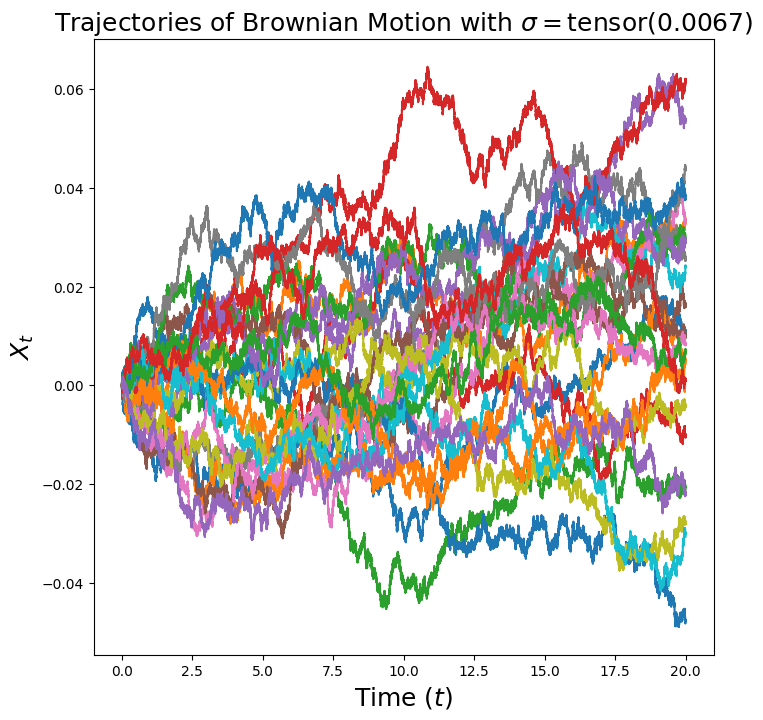

100%|██████████| 99999/99999 [00:01<00:00, 83161.96it/s]


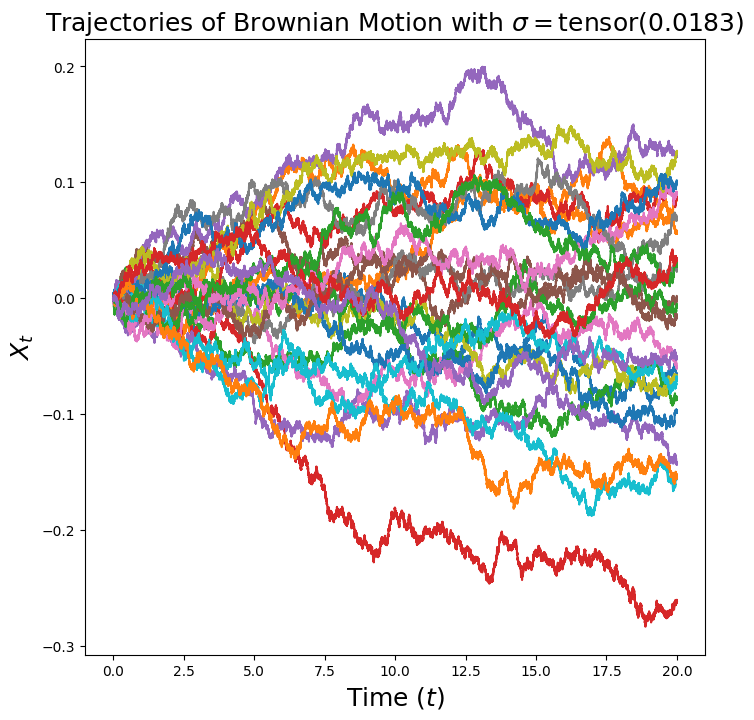

100%|██████████| 99999/99999 [00:01<00:00, 82840.15it/s]


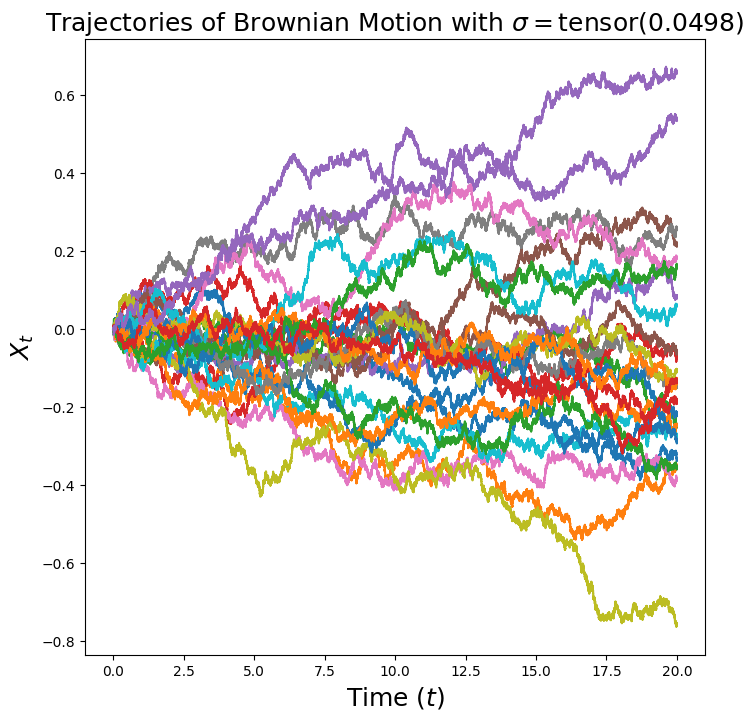

100%|██████████| 99999/99999 [00:01<00:00, 82668.66it/s]


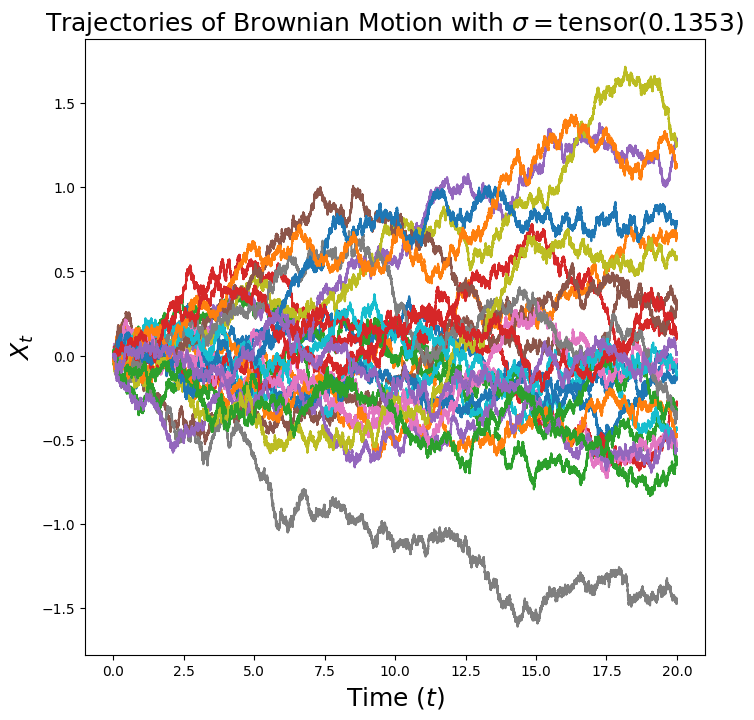

100%|██████████| 99999/99999 [00:01<00:00, 82729.35it/s]


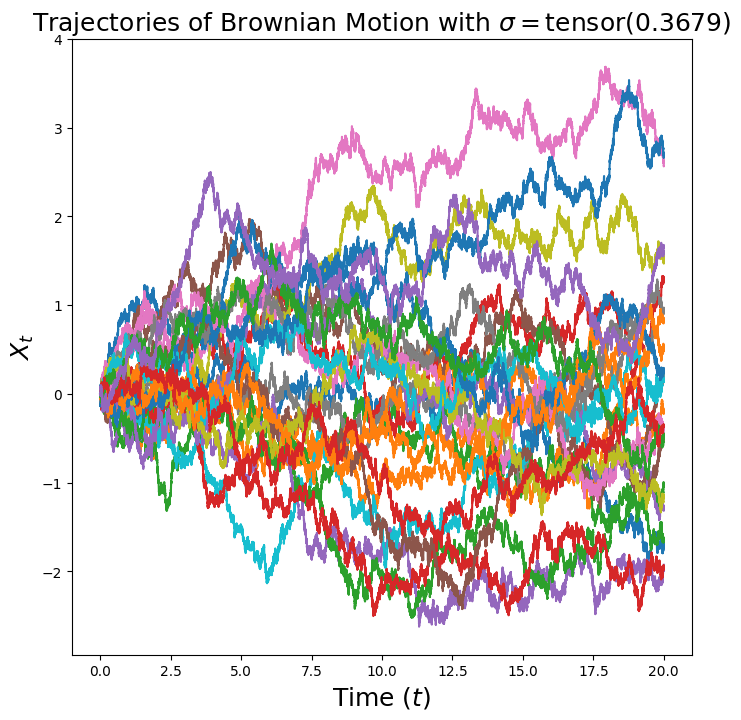

100%|██████████| 99999/99999 [00:01<00:00, 82766.32it/s]


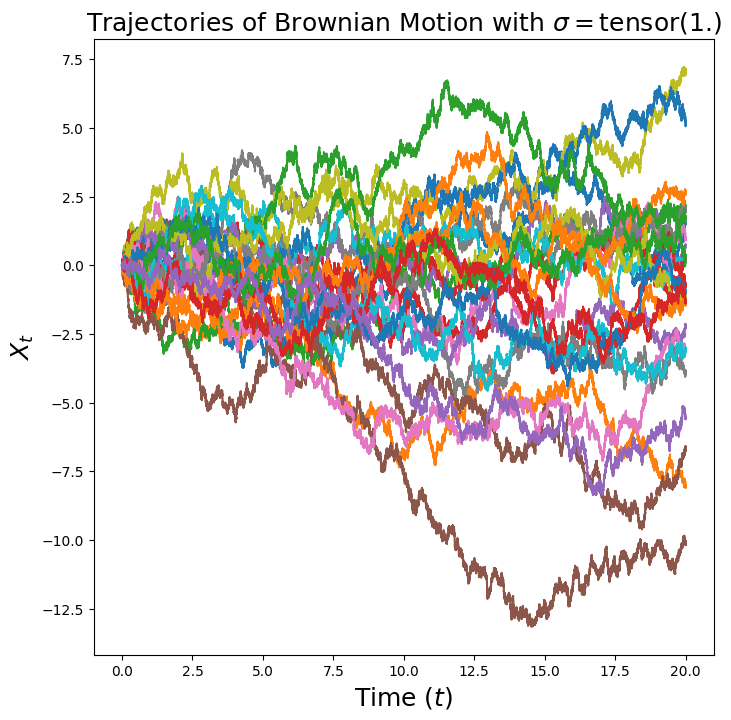

100%|██████████| 99999/99999 [00:01<00:00, 82053.90it/s]


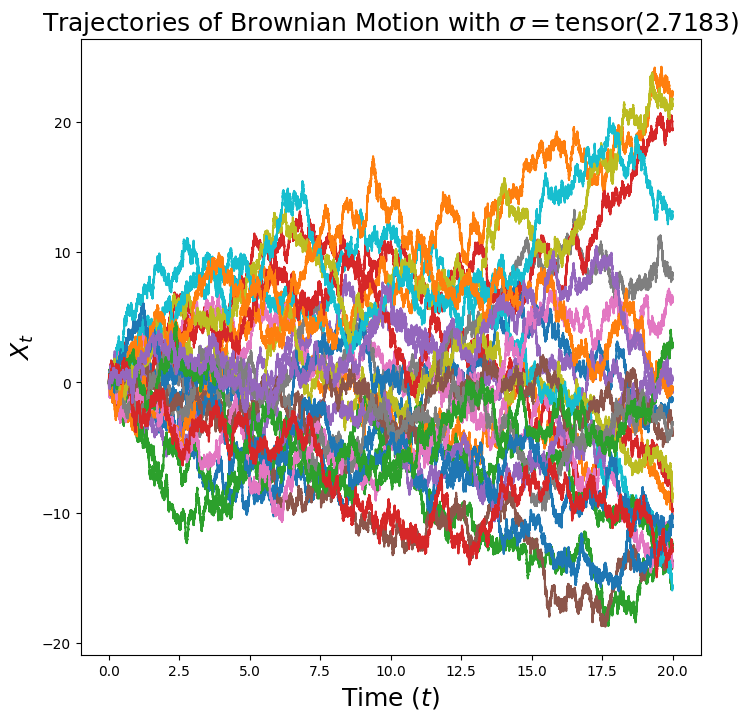

100%|██████████| 99999/99999 [00:01<00:00, 79387.36it/s]


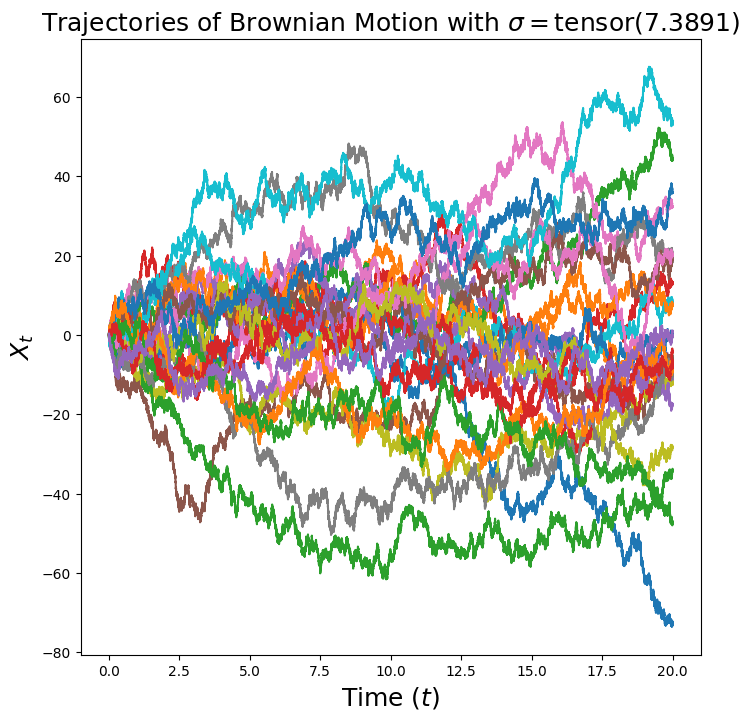

100%|██████████| 99999/99999 [00:01<00:00, 79501.53it/s]


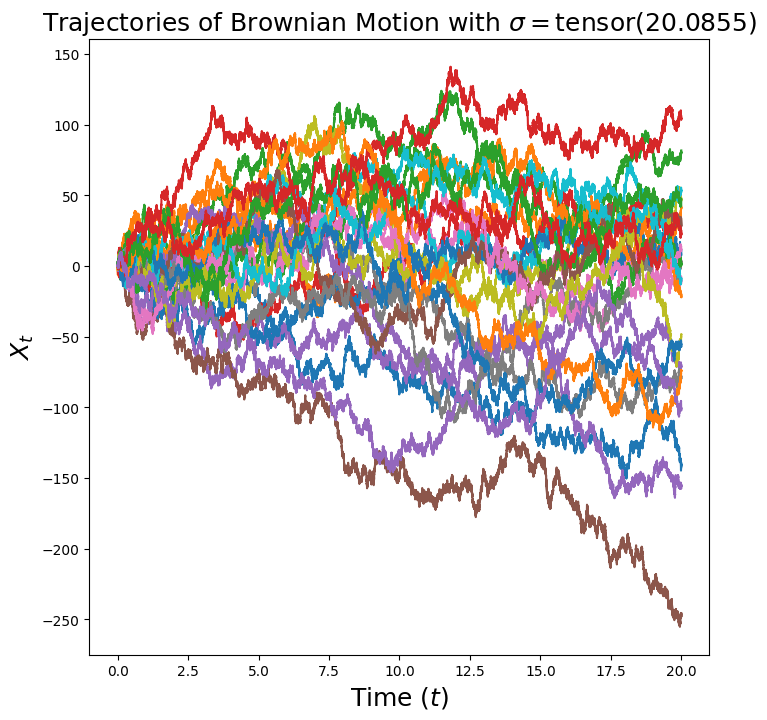

100%|██████████| 99999/99999 [00:01<00:00, 80563.51it/s]


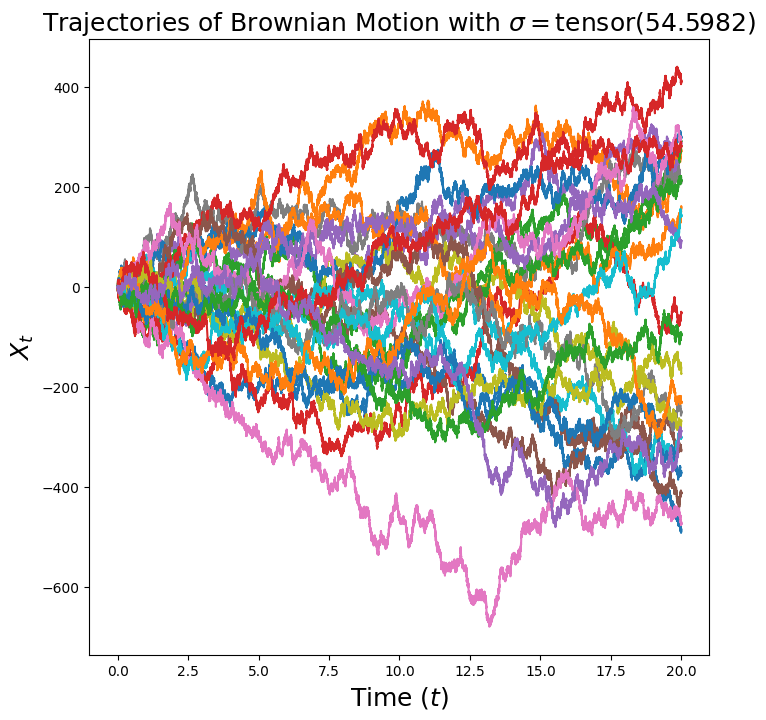

100%|██████████| 99999/99999 [00:01<00:00, 82607.62it/s]


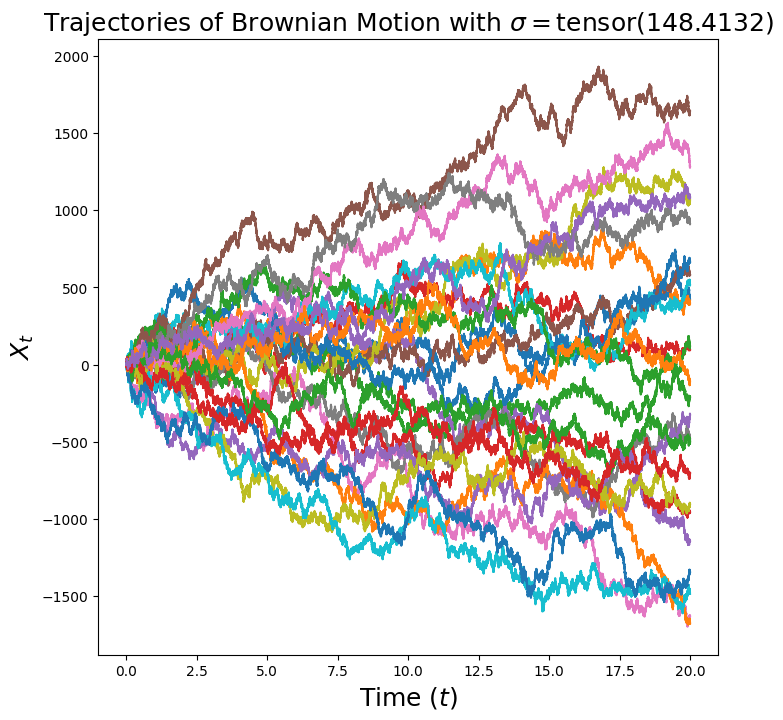

In [8]:
for log_sigma in torch.linspace(-5.0, 5.0, 11):
    sigma = torch.exp(log_sigma)
    brownian_motion = BrownianMotion(sigma)
    simulator = EulerMaruyamaSimulator(sde=brownian_motion)
    x0 = torch.zeros(25,1).to(device) # Initial values - let's start at zero --- add way more
    ts = torch.linspace(0.0,20.0,100000).to(device) # simulation timesteps (added a lot and time too)

    plt.figure(figsize=(8, 8))
    ax = plt.gca()
    ax.set_title(r'Trajectories of Brownian Motion with $\sigma=$' + str(sigma), fontsize=18)
    ax.set_xlabel(r'Time ($t$)', fontsize=18)
    ax.set_ylabel(r'$X_t$', fontsize=18)
    plot_trajectories_1d(x0, simulator, ts, ax)
    plt.show()

**Your job (1 point)**: What happens when you vary the value of `sigma`?

**Your answer**: It scales the variance of the trajectories (and their final heights on the plot). For example, noting that all the gaussian random variables are IID, the variance of the height in the end, being the sum of the displacements, is equal to the sum of the variances so its proportional for constant variance to that times the time. So if we scale sigma up, we also scale that variance in the end. Above you can see a logspace linspace set of plots to get a notion of how this varies. We should note that for this random walk we also have an expected height of zero at each timestep (by l.o.e.) and this can be confirmed above since the heights roughly sum to zero at each x.

Another way to think of sigma is just as a scaling constant: it scales the "natural units" of the variation.

### Question 2.2: Implementing an Ornstein-Uhlenbeck Process
An OU process is given by setting $u_t(X_t) = - \theta X_t$ and $\sigma_t = \sigma$, viz.,
$$ dX_t = -\theta X_t\, dt + \sigma\, dW_t, \quad \quad X_0 = x_0.$$

**Your job (1 point)**: Intuitively, what would the trajectory of $X_t$ look like for a very small value of $\theta$? What about a very large value of $\theta$?

**Your answer**: I expect it to fan out more for larger theta since it's pulled harder to the origin (and fan out more for small theta). It might converge to some sort of distribution centered at zero and that distribution should be wider for smaller theta (and fixed sigma).

**Your job (2 points)**: Fill in the `drift_coefficient` and `difusion_coefficient` methods of the `OUProcess` class below.

In [9]:
class OUProcess(SDE):
    def __init__(self, theta: float, sigma: float):
        self.theta = theta
        self.sigma = sigma
        
    def drift_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the drift coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - drift: shape (bs, dim)
        """
        # NOTE: we considered the coefficient to be the FUNCTION output, so we need to actually ad x_t here
        return -self.theta * xt # A force that pushes back towards the origin linearly (i.e. a harmonic oscillator)
        
    def diffusion_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the diffusion coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - diffusion: shape (bs, dim)
        """
        return self.sigma * torch.ones_like(xt)

In [32]:
# Does it converge to a point or a distribution? I guess a point is a dirac delta so the question is whether it always converges to a
# dirac delta. The answer below is clearly NO, visually.

simulation_time = 1000.0
num_time = 10000
h = simulation_time / (num_time - 1)
thetas_and_sigmas = [ # NOTE: 4 per row
    # Row 1
    (0.25, torch.sqrt(torch.Tensor((0.0,)))),
    (0.25, torch.sqrt(torch.Tensor((0.25,)))),
    (0.25, torch.sqrt(torch.Tensor((0.5,)))),
    (0.25, torch.sqrt(torch.Tensor((1.0,)))),
    # Row 2
    (0.5, torch.sqrt(torch.Tensor((0.0,)))),
    (0.5, torch.sqrt(torch.Tensor((0.25,)))),
    (0.5, torch.sqrt(torch.Tensor((0.5,)))),
    (0.5, torch.sqrt(torch.Tensor((1.0,)))),
    # Row 3
    (1, torch.sqrt(torch.Tensor((0.0,)))),
    (1, torch.sqrt(torch.Tensor((0.25,)))),
    (1, torch.sqrt(torch.Tensor((0.5,)))),
    (1, torch.sqrt(torch.Tensor((1.0,)))),
    # NOTE: 2nd set of rows tries to test a hypothesis that there is a specific value of sigma relative to theta such that a distribution is maintained:
    # (1 - theta^2) sigma_1^2 + sigma_2^2 = sigma_1^2 => ratio of sigmas = sqrt(1 - theta^2) & try at ratio = 1 and sigma = 1; does not show particularly
    # different behavior
    # Row 4 (1)
    (0.25, torch.sqrt(torch.Tensor((0.0,)))),
    (0.25, torch.sqrt(torch.Tensor((0.25,)))),
    (0.25, torch.sqrt(torch.Tensor((0.5,)))),
    (0.25, torch.sqrt(torch.Tensor((1.0,)))),
    # Row 5 (2)
    (torch.sqrt(torch.Tensor((2,))), torch.sqrt(torch.Tensor((0.0,)))),
    (torch.sqrt(torch.Tensor((2,))), torch.sqrt(torch.Tensor((0.25,)))),
    (torch.sqrt(torch.Tensor((2,))), torch.sqrt(torch.Tensor((0.5,)))),
    (torch.sqrt(torch.Tensor((2,))), torch.sqrt(torch.Tensor((1.0,)))),
    # Row 6 (3)
    (1, torch.sqrt(torch.Tensor((0.0,)))),
    (1, torch.sqrt(torch.Tensor((0.25,)))),
    (1, torch.sqrt(torch.Tensor((0.5,)))),
    (1, torch.sqrt(torch.Tensor((1.0,)))),
    # NOTE: third set is just meant to help us test for explosions - appears not to happen, in all cases these converge to a distribution
    # Row 7 (1)
    (1, torch.sqrt(torch.Tensor((0.0,)))),
    (1, torch.sqrt(torch.Tensor((1.0,)))),
    (1, torch.sqrt(torch.Tensor((10.0,)))),
    (1, torch.sqrt(torch.Tensor((100.0,)))),
    # NOTE: next set is just meant to try and break the convergence of the distribution to see what happens... (I think
    # we will get some kinda oscillation; it's just the analysis that is not working)
    # Row 8 (1)
    (0.5/h, torch.sqrt(torch.Tensor((1.0,)))),
    (0.9/h, torch.sqrt(torch.Tensor((1.0,)))),
    (1.1/h, torch.sqrt(torch.Tensor((1.0,)))),
    (10/h, torch.sqrt(torch.Tensor((1.0,)))),
]

simulations = []

num_plots = len(thetas_and_sigmas)
assert num_plots % 4 == 0
fig, axes = plt.subplots(num_plots // 4, 4, figsize=(14 * (num_plots // 4), 50))

for idx, (theta, sigma) in enumerate(thetas_and_sigmas):
    ou_process = OUProcess(theta, sigma)
    simulator = EulerMaruyamaSimulator(sde=ou_process)
    x0 = torch.linspace(-50.0,50.0,1000).view(-1,1).to(device) # Initial values - let's start at zero
    ts = torch.linspace(0.0,simulation_time,num_time).to(device) # simulation timesteps

    # print(idx) # DEBUG
    x = idx // 4
    y = idx % 4
    assert 0 <= x <= 7
    assert 0 <= y <= 3
    ax = axes[x][y]
    ax.set_title(f'Trajectories of OU Process with $\\sigma = ${sigma}, $\\theta = ${theta}', fontsize=15)
    ax.set_xlabel(r'Time ($t$)', fontsize=15)
    ax.set_ylabel(r'$X_t$', fontsize=15)
    trajectories = plot_trajectories_1d(x0, simulator, ts, ax)
    simulations.append((ts, trajectories))
fig.tight_layout()
plt.show()

100%|██████████| 9999/9999 [00:00<00:00, 22731.50it/s]


ValueError: cannot convert float NaN to integer

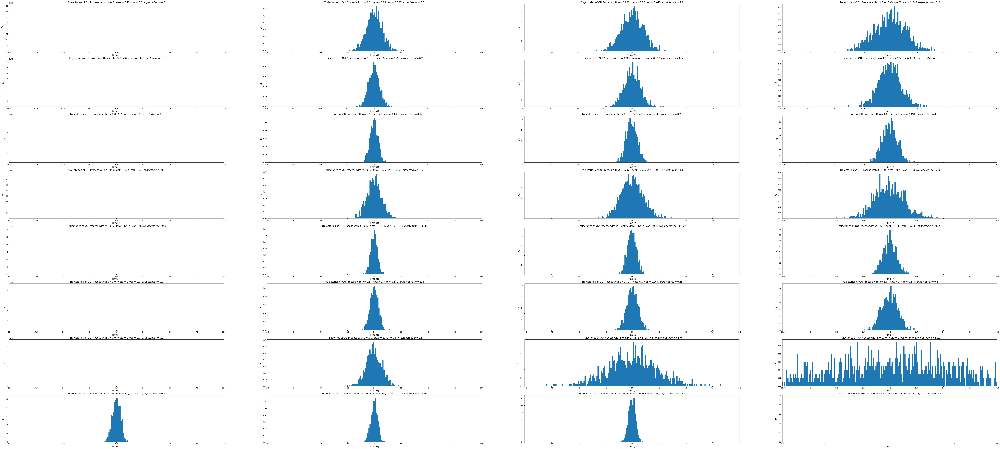

In [33]:
# NOTE: now we try to plot distributions for each of the simulations
# NOTE: we just take the last element of the trajectory because it approximates the limitting distribution
num_plots = len(thetas_and_sigmas)
assert num_plots % 4 == 0
fig, axes = plt.subplots(num_plots // 4, 4, figsize=(14 * (num_plots // 4), 50))

expected_variances = [
    sigma**2 / (2 * theta) for theta, sigma in thetas_and_sigmas
]

# print(simulations[0][1].shape)
assert all(len(tr.shape) == 3 and tr.shape[-1] == 1 for _, tr in simulations) # ONLY 1D allowed
for idx, ((theta, sigma), (ts, trajectories)) in enumerate(zip(thetas_and_sigmas, simulations)):
    ax = axes[idx // 4][idx % 4]
    sample_variance = trajectories[:, -1, 0].var()
    theta_rounded = round((theta if isinstance(theta, float) or isinstance(theta, int) else theta.item()), 3)
    sigma_rounded = round((sigma if isinstance(sigma, float) or isinstance(sigma, int) else sigma.item()), 3)
    sample_variance_rounded = round((sample_variance if isinstance(sample_variance, float) or isinstance(sample_variance, int) else sample_variance.item()), 3)
    expected_variance_rounded = round((expected_variances[idx].item()), 3)
    ax.set_title(f'Trajectories of OU Process with $\\sigma = ${sigma_rounded}, $\\\theta = ${theta_rounded}, var = ${sample_variance_rounded}, expected var = ${expected_variance_rounded}', fontsize=15)
    ax.set_xlabel(r'Time ($t$)', fontsize=15)
    ax.set_ylabel(r'$X_t$', fontsize=15)
    # 1st axis is batch, 2nd axis is time
    plotees = trajectories[:, -1, 0].cpu()
    drange = plotees.max() - plotees.min()
    ax.hist(plotees, bins=max(1, int(drange * 10)), density=True)
    ax.set_xlim(-10, 10)
fig.tight_layout()
plt.show()

# Result: looks kinda gaussian. If we expand the sum above we see that we are doing:
# x_n = (1 - h*theta) * ((1- h*theta) * (...) + sqrt(h) * sigma * z_{n-1}) + sigma * z_n = (1- h * theta)^n x_0 + sqrt(h) * sigma * (1-theta)^n * z_0 + ...
# where z_i is from isotropic variance 1 gaussian
# => Because this is a hella big convolution:
#    1. The result is approximately gaussian (and will be gaussian if x_0 is gaussian)
#    2. Variance is of indp. rv. so it will be the sum of these variances which is the sum of the (1 - h * theta)^2k (for each k) dot sigma^2
#       => Variance = sigma^2 * h * sum_of_thetas = sigma^2 / (1 - (1 - h * theta)^2) = sigma^2 / (2 * h * theta - h^2 * theta^2) = some constant (a) scaling up sigma and (b) down by theta as well
#           SO LONG AS 2htheta > h^2theta^2 => 2/h > theta (we can use a derivative also to see that this is increasing: 2h - 2htheta > 0 for theta < 1 and decreasing until theta = 2/h)
#       => VARIANCE IS APPROXIMATELY sigma^2 / 2 theta for very small h !!! (acc. to AI and wikipedia this is what we expect anyways)
#       => As you scale up by theta, the denominator goes UP and therefore the variance in total goes DOWN (for small theta)
#      ...
#      NOTE In the last row we are scaling by theta up to the critical point based on the value of h (i.e. 2/h)


**Your job (1 point)**: What do you notice about the convergence of the solutions? Are they converging to a particular point? Or to a distribution? Your answer should be two *qualitative* sentences of the form: "When ($\theta$ or $\sigma$) goes (up or down), we see...".

**Hint**: Pay close attention to the ratio $D \triangleq \frac{\sigma^2}{\theta}$ (see the next few cells below!).

**Your answer**: As you can it (1) everything converges to something that LOOKS like a gaussian distribution (ish) with the tales clipped because we start with a uniform distribution (meaning there is a maximum attainable in finite time) and (2) you can get the variance to be zero for your gaussian (i.e. when sigma = 0 as you see on the left above) and (3) increasing theta makes the distribution tigher and increasing sigma makes the distribution wider (in the `theta < 2 / h` regime); empirically increasing theta more decreases the width of the gaussian even further when `theta > 2 / h` for small overflow values, and increasing for very large values (thus: we got NaN). This is to be expected because the cancellation is self-destructing so long as you are going over by only a little bit, and otherwise exploding. We leave the error message above to highlight this.

Lastly, you can see that the estimated theta from the approximation as `h -> infty` is relatively close to the actual theta (if you try other formulas, it's farther).

The hint from the ratio is probably hinting at the notion that half that ratio is approximately proportional to that limiting distribution's variance.

In [12]:
def plot_scaled_trajectories_1d(x0: torch.Tensor, simulator: Simulator, timesteps: torch.Tensor, time_scale: float, label: str, ax: Optional[Axes] = None):
        """
        Graphs the trajectories of a one-dimensional SDE with given initial values (x0) and simulation timesteps (timesteps).
        Args:
            - x0: state at time t, shape (num_trajectories, 1)
            - simulator: Simulator object used to simulate
            - t: timesteps to simulate along, shape (num_timesteps,)
            - time_scale: scalar by which to scale time
            - label: self-explanatory
            - ax: pyplot Axes object to plot on
        """
        if ax is None:
            ax = plt.gca()
        trajectories = simulator.simulate_with_trajectory(x0, timesteps) # (num_trajectories, num_timesteps, ...)
        for trajectory_idx in range(trajectories.shape[0]):
            trajectory = trajectories[trajectory_idx, :, 0] # (num_timesteps,)
            ax.plot(ts.cpu() * time_scale, trajectory.cpu(), label=label)

100%|██████████| 999/999 [00:00<00:00, 71429.22it/s]


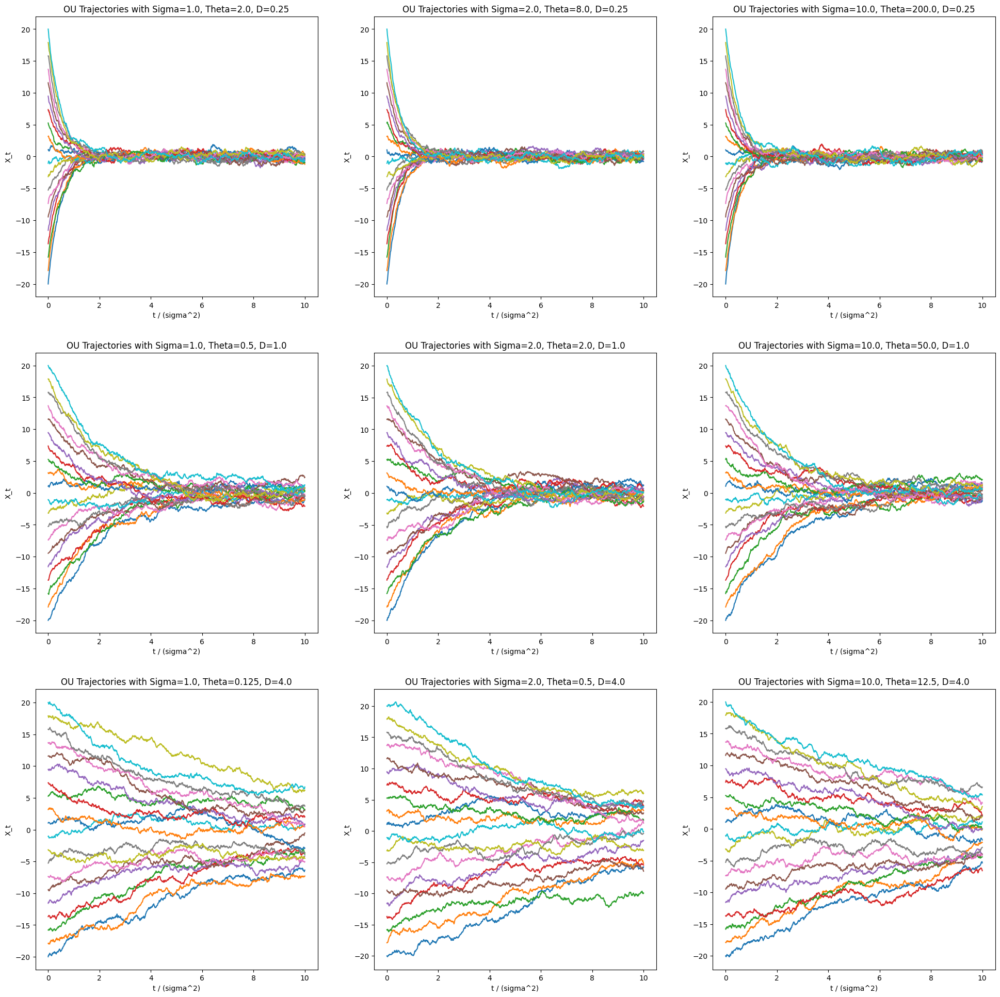

In [34]:
# Let's try rescaling with time
sigmas = [1.0, 2.0, 10.0]
ds = [0.25, 1.0, 4.0] # sigma**2 / 2t
simulation_time = 10.0

fig, axes = plt.subplots(len(ds), len(sigmas), figsize=(8 * len(sigmas), 8 * len(ds)))
axes = axes.reshape((len(ds), len(sigmas)))
for d_idx, d in enumerate(ds):
    for s_idx, sigma in enumerate(sigmas):
        theta = sigma**2 / 2 / d
        ou_process = OUProcess(theta, sigma)
        simulator = EulerMaruyamaSimulator(sde=ou_process)
        x0 = torch.linspace(-20.0,20.0,20).view(-1,1).to(device)
        time_scale = sigma**2
        ts = torch.linspace(0.0,simulation_time / time_scale,1000).to(device) # simulation timesteps
        ax = axes[d_idx, s_idx]
        plot_scaled_trajectories_1d(x0=x0, simulator=simulator, timesteps=ts, time_scale=time_scale, label=f'Sigma = {sigma}', ax=ax)
        ax.set_title(f'OU Trajectories with Sigma={sigma}, Theta={theta}, D={d}')
        ax.set_xlabel(f't / (sigma^2)')
        ax.set_ylabel('X_t')
plt.show()

**Your job (1 point)**: What conclusion can we draw from the figure above? One qualitative sentence is fine. We'll revisit this in Section 3.2.

**Your answer**: Increasing sigma increases the variance nad increasing theta decreases the variance. When `sigma^2/theta` is constant (or likewise, `sigma^2/2theta` is constant), the variance is constant (visually at least): look above at `sigma=1, theta=0.5` vs `sigma=2, theta=2` (double sigma means x4 increase and quad. theta means x4 decrease => cancels out; the two plots look similar). In these plots the `t` is scaled, but that doesn't change these visuals for two reasons: (1) you notice that ALL plots have the same scale on both axes, (2) the y scale is what matters for this sort of variance in the VALUES of the LIMITING distribution (the eventual distribution of the points' targets as you go to the right on the plot); scaling time simply lets us see the convergence in some kind of canonical units. It is hard to say whether these are all converging at the same speed or not, since some distributions are wider, but visually it seems like the convergence rates are NOT the same. The ones near the top (smaller D ratios) converge faster.

# Part 3: Transforming Distributions with SDEs
In the previous section, we observed how individual *points* are transformed by an SDE. Ultimately, we are interested in understanding how *distributions* are transformed by an SDE (or an ODE...). After all, our goal is to design ODEs and SDEs which transform a noisy distribution (such as the Gaussian $N(0, I_d)$), to the data distribution $p_{\text{data}}$ of interest. In this section, we will visualize how distributions are transformed by a very particular family of SDEs: *Langevin dynamics*.

First, let's define some distributions to play around with. In practice, there are two qualities one might hope a distribution to have:
1. The first quality is that one can measure the *density* of a distribution $p(x)$. This ensures that we can compute the gradient $\nabla \log p(x)$ of the log density. This quantity is known as the *score* of $p$, and paints a picture of the local geometry of the distribution. Using the score, we will construct and simulate the *Langevin dynamics*, a family of SDEs which "drive" samples toward the distribution $\pi$. In particular, the Langevin dynamics *preserve* the distribution $p(x)$. In Lecture 2, we will make this notion of driving more precise.
2. The second quality is that we can draw samples from the distribution $p(x)$.
For simple, toy distributions, such as Gaussians and simple mixture models, it is often true that both qualities are satisfied. For more complex choices of $p$, such as distributions over images, we can sample but cannot measure the density.

In [35]:
class Density(ABC):
    """
    Distribution with tractable density
    """
    @abstractmethod
    def log_density(self, x: torch.Tensor) -> torch.Tensor:
        """
        Returns the log density at x.
        Args:
            - x: shape (batch_size, dim)
        Returns:
            - log_density: shape (batch_size, 1)
        """
        pass

    def score(self, x: torch.Tensor) -> torch.Tensor:
        """
        Returns the score dx log density(x)
        Args:
            - x: (batch_size, dim)
        Returns:
            - score: (batch_size, dim)
        """
        x = x.unsqueeze(1)  # (batch_size, 1, ...)
        score = vmap(jacrev(self.log_density))(x)  # (batch_size, 1, 1, 1, ...)
        return score.squeeze((1, 2, 3))  # (batch_size, ...)

class Sampleable(ABC):
    """
    Distribution which can be sampled from
    """
    @abstractmethod
    def sample(self, num_samples: int) -> torch.Tensor:
        """
        Returns the log density at x.
        Args:
            - num_samples: the desired number of samples
        Returns:
            - samples: shape (batch_size, dim)
        """
        pass

In [36]:
# Several plotting utility functions
def hist2d_sampleable(sampleable: Sampleable, num_samples: int, ax: Optional[Axes] = None, **kwargs):
    if ax is None:
        ax = plt.gca()
    samples = sampleable.sample(num_samples) # (ns, 2)
    ax.hist2d(samples[:,0].cpu(), samples[:,1].cpu(), **kwargs)

def scatter_sampleable(sampleable: Sampleable, num_samples: int, ax: Optional[Axes] = None, **kwargs):
    if ax is None:
        ax = plt.gca()
    samples = sampleable.sample(num_samples) # (ns, 2)
    ax.scatter(samples[:,0].cpu(), samples[:,1].cpu(), **kwargs)

def imshow_density(density: Density, bins: int, scale: float, ax: Optional[Axes] = None, **kwargs):
    if ax is None:
        ax = plt.gca()
    x = torch.linspace(-scale, scale, bins).to(device)
    y = torch.linspace(-scale, scale, bins).to(device)
    X, Y = torch.meshgrid(x, y)
    xy = torch.stack([X.reshape(-1), Y.reshape(-1)], dim=-1)
    density = density.log_density(xy).reshape(bins, bins).T
    im = ax.imshow(density.cpu(), extent=[-scale, scale, -scale, scale], origin='lower', **kwargs)

def contour_density(density: Density, bins: int, scale: float, ax: Optional[Axes] = None, **kwargs):
    if ax is None:
        ax = plt.gca()
    x = torch.linspace(-scale, scale, bins).to(device)
    y = torch.linspace(-scale, scale, bins).to(device)
    X, Y = torch.meshgrid(x, y)
    xy = torch.stack([X.reshape(-1), Y.reshape(-1)], dim=-1)
    density = density.log_density(xy).reshape(bins, bins).T
    im = ax.contour(density.cpu(), extent=[-scale, scale, -scale, scale], origin='lower', **kwargs)

In [37]:
class Gaussian(torch.nn.Module, Sampleable, Density):
    """
    Two-dimensional Gaussian. Is a Density and a Sampleable. Wrapper around torch.distributions.MultivariateNormal
    """
    def __init__(self, mean, cov):
        """
        mean: shape (2,)
        cov: shape (2,2)
        """
        super().__init__()
        self.register_buffer("mean", mean)
        self.register_buffer("cov", cov)

    @property
    def distribution(self):
        return D.MultivariateNormal(self.mean, self.cov, validate_args=False)

    def sample(self, num_samples) -> torch.Tensor:
        return self.distribution.sample((num_samples,))

    def log_density(self, x: torch.Tensor):
        return self.distribution.log_prob(x).view(-1, 1)

class GaussianMixture(torch.nn.Module, Sampleable, Density):
    """
    Two-dimensional Gaussian mixture model, and is a Density and a Sampleable. Wrapper around torch.distributions.MixtureSameFamily.
    """
    def __init__(
        self,
        means: torch.Tensor,  # nmodes x data_dim
        covs: torch.Tensor,  # nmodes x data_dim x data_dim
        weights: torch.Tensor,  # nmodes
    ):
        """
        means: shape (nmodes, 2)
        covs: shape (nmodes, 2, 2)
        weights: shape (nmodes, 1)
        """
        super().__init__()
        self.nmodes = means.shape[0]
        self.register_buffer("means", means)
        self.register_buffer("covs", covs)
        self.register_buffer("weights", weights)

    @property
    def dim(self) -> int:
        return self.means.shape[1]

    @property
    def distribution(self):
        return D.MixtureSameFamily(
                mixture_distribution=D.Categorical(probs=self.weights, validate_args=False),
                component_distribution=D.MultivariateNormal(
                    loc=self.means,
                    covariance_matrix=self.covs,
                    validate_args=False,
                ),
                validate_args=False,
            )

    def log_density(self, x: torch.Tensor) -> torch.Tensor:
        return self.distribution.log_prob(x).view(-1, 1)

    def sample(self, num_samples: int) -> torch.Tensor:
        return self.distribution.sample(torch.Size((num_samples,)))

    @classmethod
    def random_2D(
        cls, nmodes: int, std: float, scale: float = 10.0, seed = 0.0
    ) -> "GaussianMixture":
        torch.manual_seed(seed)
        means = (torch.rand(nmodes, 2) - 0.5) * scale
        covs = torch.diag_embed(torch.ones(nmodes, 2)) * std ** 2
        weights = torch.ones(nmodes)
        return cls(means, covs, weights)

    @classmethod
    def symmetric_2D(
        cls, nmodes: int, std: float, scale: float = 10.0,
    ) -> "GaussianMixture":
        angles = torch.linspace(0, 2 * np.pi, nmodes + 1)[:nmodes]
        means = torch.stack([torch.cos(angles), torch.sin(angles)], dim=1) * scale
        covs = torch.diag_embed(torch.ones(nmodes, 2) * std ** 2)
        weights = torch.ones(nmodes) / nmodes
        return cls(means, covs, weights)

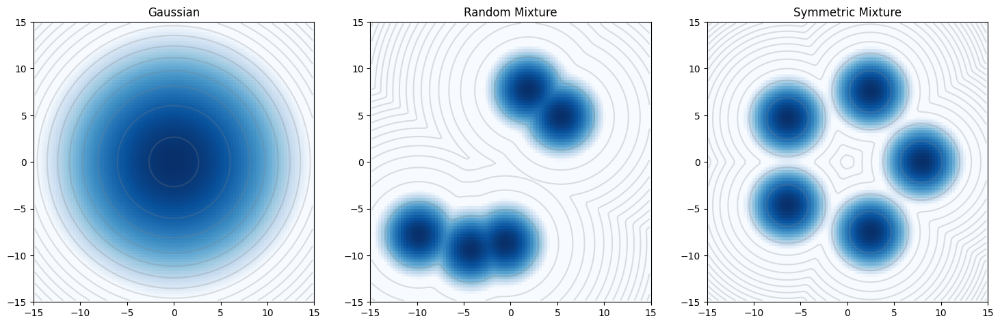

In [43]:
# Visualize densities
densities = {
    "Gaussian": Gaussian(mean=torch.zeros(2), cov=10 * torch.eye(2)).to(device),
    "Random Mixture": GaussianMixture.random_2D(nmodes=5, std=1.0, scale=20.0, seed=3.0).to(device),
    "Symmetric Mixture": GaussianMixture.symmetric_2D(nmodes=5, std=1.0, scale=8.0).to(device),
}

fig, axes = plt.subplots(1,3, figsize=(18, 6))
bins = 100
scale = 15
for idx, (name, density) in enumerate(densities.items()):
    ax = axes[idx]
    ax.set_title(name)
    imshow_density(density, bins, scale, ax, vmin=-15, cmap=plt.get_cmap('Blues'))
    contour_density(density, bins, scale, ax, colors='grey', linestyles='solid', alpha=0.25, levels=20)
plt.show()


### Question 3.1: Implementing Langevin Dynamics

In this section, we'll simulate the (overdamped) Langevin dynamics $$dX_t = \frac{1}{2} \sigma^2\nabla \log p(X_t) dt + \sigma dW_t.$$

**Your job (2 points)**: Fill in the `drift_coefficient` and `diffusion_coefficient` methods of the class `LangevinSDE` below.

**Hint**: Use `Density.score` to access the score.

In [44]:
class LangevinSDE(SDE):
    def __init__(self, sigma: float, density: Density):
        self.sigma = sigma
        self.density = density
        
    def drift_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the drift coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - drift: shape (bs, dim)
        """
        return 0.5 * self.sigma**2 * self.density.score(xt)
        
    def diffusion_coefficient(self, xt: torch.Tensor, t: torch.Tensor) -> torch.Tensor:
        """
        Returns the diffusion coefficient of the ODE.
        Args:
            - xt: state at time t, shape (bs, dim)
            - t: time, shape ()
        Returns:
            - diffusion: shape (bs, dim)
        """
        return self.sigma * torch.ones_like(xt)

Now, let's graph the results!

In [45]:
# First, let's define two utility functions...
def every_nth_index(num_timesteps: int, n: int) -> torch.Tensor:
    """
    Compute the indices to record in the trajectory
    """
    if n == 1:
        return torch.arange(num_timesteps)
    return torch.cat(
        [
            torch.arange(0, num_timesteps - 1, n),
            torch.tensor([num_timesteps - 1]),
        ]
    )

def graph_dynamics(
    num_samples: int,
    source_distribution: Sampleable,
    simulator: Simulator, 
    density: Density,
    timesteps: torch.Tensor, 
    plot_every: int,
    bins: int,
    scale: float
):
    """
    Plot the evolution of samples from source under the simulation scheme given by simulator (itself a discretization of an ODE or SDE).
    Args:
        - num_samples: the number of samples to simulate
        - source_distribution: distribution from which we draw initial samples at t=0
        - simulator: the discertized simulation scheme used to simulate the dynamics
        - density: the target density
        - timesteps: the timesteps used by the simulator
        - plot_every: number of timesteps between consecutive plots
        - bins: number of bins for imshow
        - scale: scale for imshow
    """
    # Simulate
    x0 = source_distribution.sample(num_samples)
    xts = simulator.simulate_with_trajectory(x0, timesteps)
    indices_to_plot = every_nth_index(len(timesteps), plot_every)
    plot_timesteps = timesteps[indices_to_plot]
    plot_xts = xts[:,indices_to_plot]

    # Graph
    fig, axes = plt.subplots(2, len(plot_timesteps), figsize=(8*len(plot_timesteps), 16))
    axes = axes.reshape((2,len(plot_timesteps)))
    for t_idx in range(len(plot_timesteps)):
        t = plot_timesteps[t_idx].item()
        xt = xts[:,t_idx]
        # Scatter axes
        scatter_ax = axes[0, t_idx]
        imshow_density(density, bins, scale, scatter_ax, vmin=-15, alpha=0.25, cmap=plt.get_cmap('Blues'))
        scatter_ax.scatter(xt[:,0].cpu(), xt[:,1].cpu(), marker='x', color='black', alpha=0.75, s=15)
        scatter_ax.set_title(f'Samples at t={t:.1f}', fontsize=15)
        scatter_ax.set_xticks([])
        scatter_ax.set_yticks([])

        # Kdeplot axes
        kdeplot_ax = axes[1, t_idx]
        imshow_density(density, bins, scale, kdeplot_ax, vmin=-15, alpha=0.5, cmap=plt.get_cmap('Blues'))
        sns.kdeplot(x=xt[:,0].cpu(), y=xt[:,1].cpu(), alpha=0.5, ax=kdeplot_ax,color='grey')
        kdeplot_ax.set_title(f'Density of Samples at t={t:.1f}', fontsize=15)
        kdeplot_ax.set_xticks([])
        kdeplot_ax.set_yticks([])
        kdeplot_ax.set_xlabel("")
        kdeplot_ax.set_ylabel("")

    plt.show()

100%|██████████| 999/999 [00:00<00:00, 1333.23it/s]


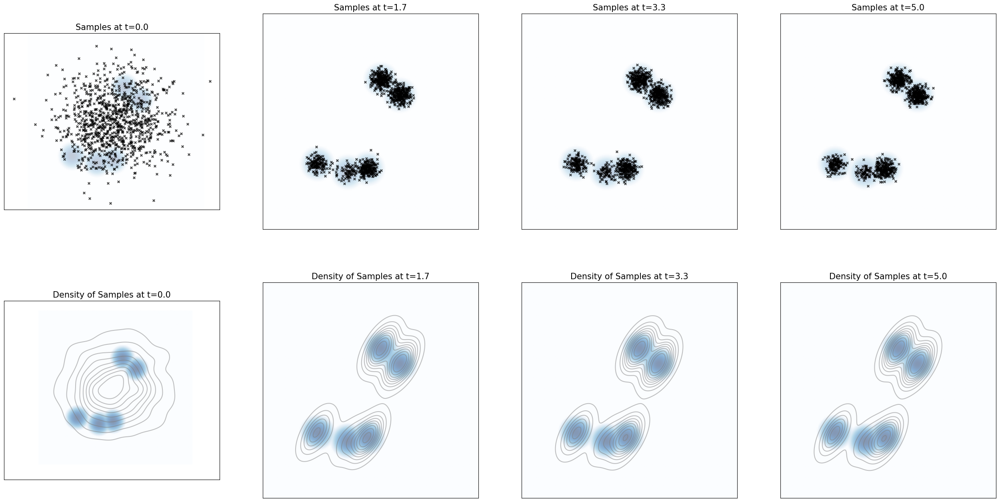

100%|██████████| 999/999 [00:00<00:00, 1390.80it/s]


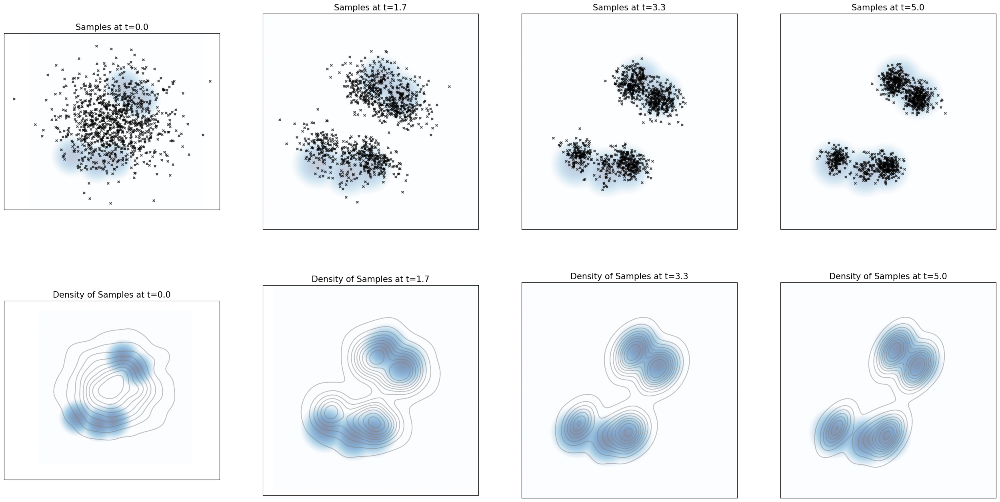

100%|██████████| 999/999 [00:00<00:00, 1398.56it/s]


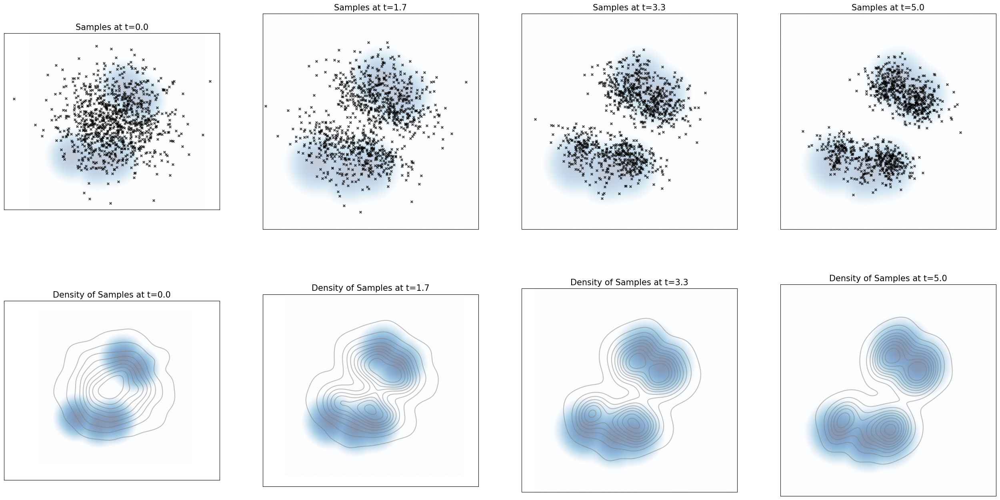

100%|██████████| 999/999 [00:00<00:00, 1330.55it/s]


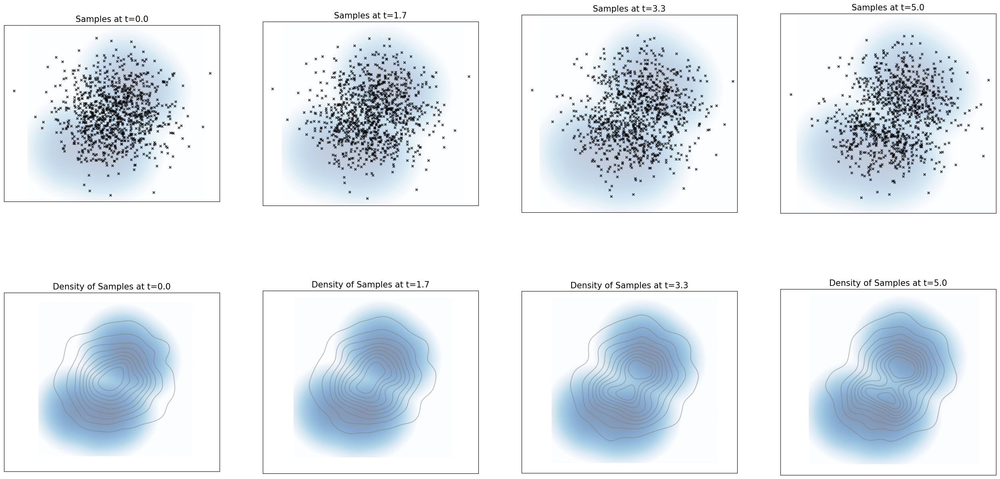

In [51]:
# Construct the simulator
for std in [0.5, 0.75, 1.0, 2.0]:
    target = GaussianMixture.random_2D(nmodes=5, std=std, scale=15.0, seed=3.0).to(device)
    sde = LangevinSDE(sigma = 10.0, density = target)
    simulator = EulerMaruyamaSimulator(sde)

    # Graph the results!
    graph_dynamics(
        num_samples = 1000,
        source_distribution = Gaussian(mean=torch.zeros(2), cov=20 * torch.eye(2)).to(device),
        simulator=simulator,
        density=target,
        timesteps=torch.linspace(0,5.0,1000).to(device),
        plot_every=334,
        bins=200,
        scale=15
    )   

100%|██████████| 999/999 [00:00<00:00, 1042.30it/s]


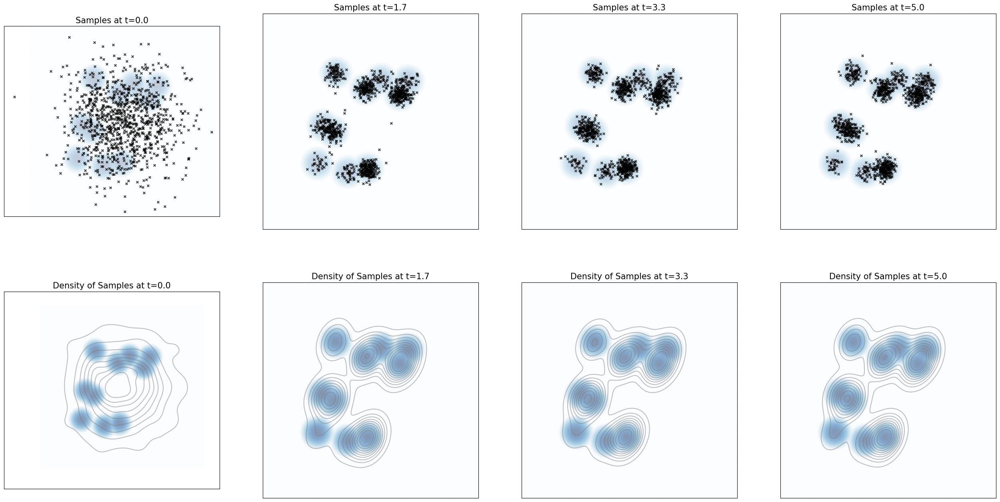

100%|██████████| 999/999 [00:00<00:00, 1068.69it/s]


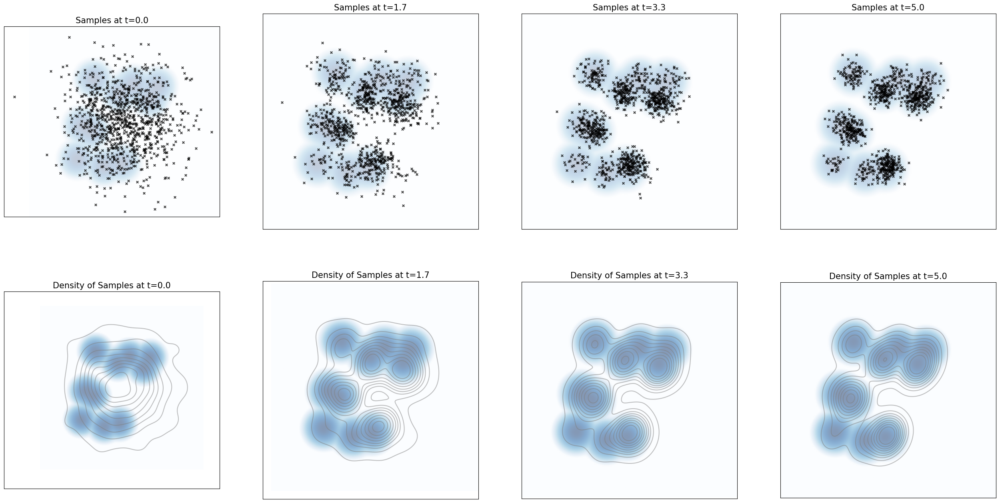

100%|██████████| 999/999 [00:01<00:00, 935.56it/s]


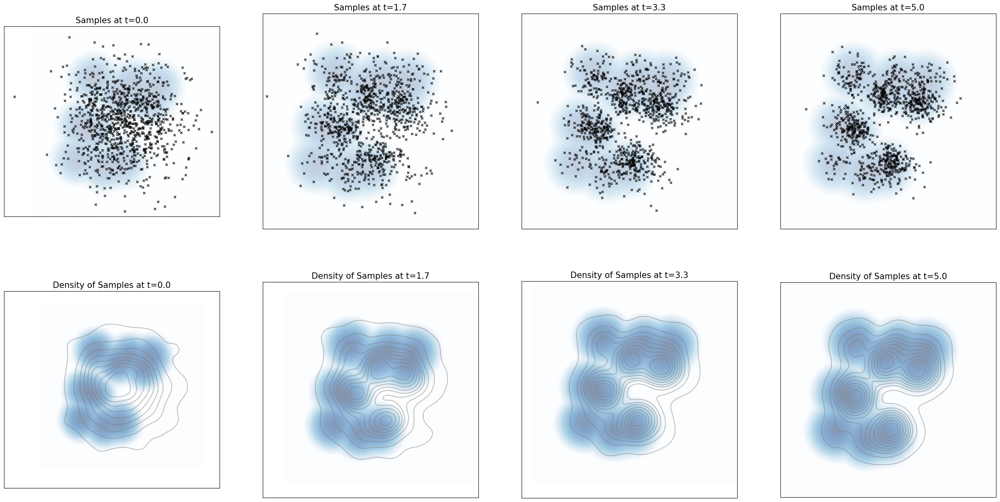

100%|██████████| 999/999 [00:00<00:00, 1039.79it/s]


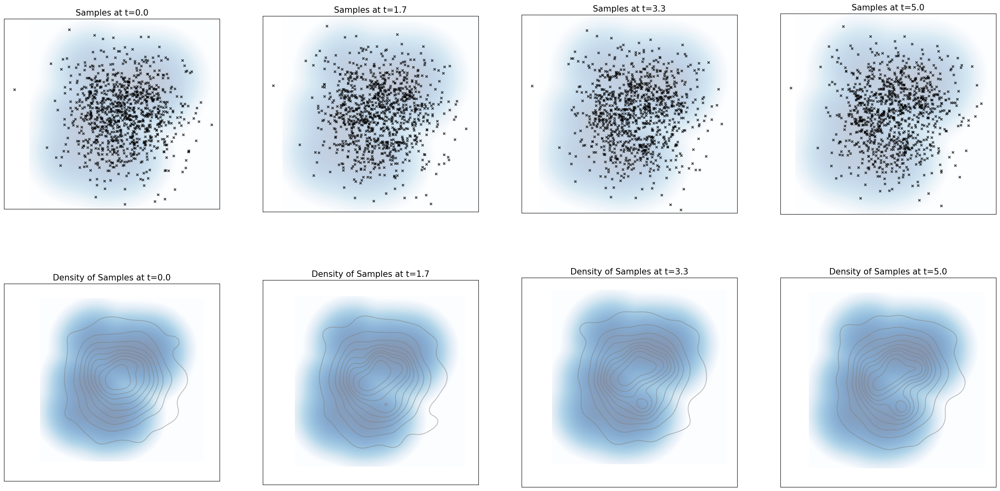

In [52]:
# Construct the simulator
for std in [0.5, 0.75, 1.0, 2.0]:
    target = GaussianMixture.random_2D(nmodes=10, std=std, scale=15.0, seed=3.0).to(device)
    sde = LangevinSDE(sigma = 10.0, density = target)
    simulator = EulerMaruyamaSimulator(sde)

    # Graph the results!
    graph_dynamics(
        num_samples = 1000,
        source_distribution = Gaussian(mean=torch.zeros(2), cov=20 * torch.eye(2)).to(device),
        simulator=simulator,
        density=target,
        timesteps=torch.linspace(0,5.0,1000).to(device),
        plot_every=334,
        bins=200,
        scale=15
    )   

100%|██████████| 999/999 [00:00<00:00, 1024.24it/s]


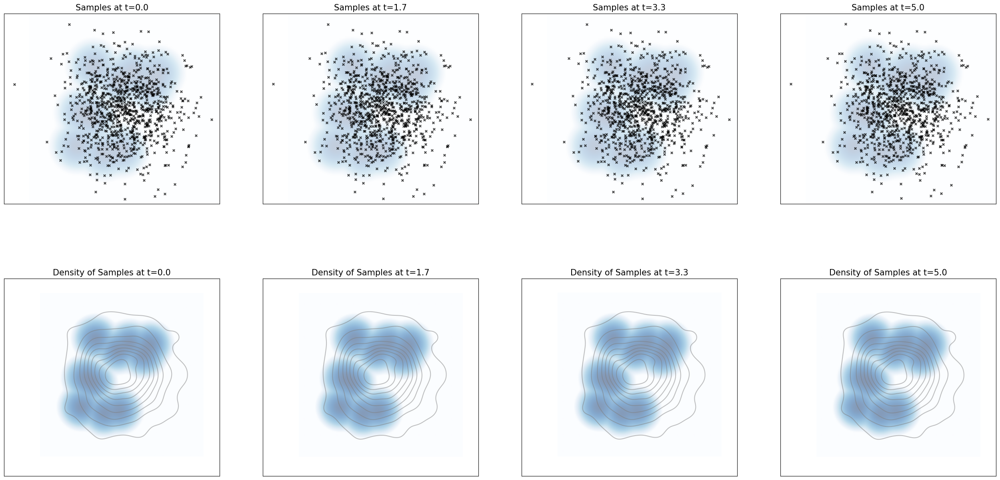

100%|██████████| 999/999 [00:01<00:00, 973.24it/s] 


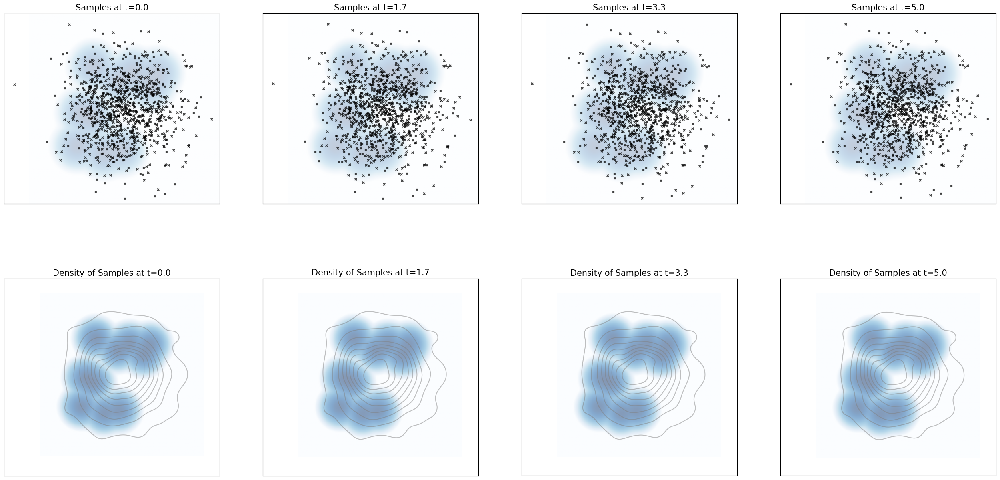

100%|██████████| 999/999 [00:00<00:00, 1012.07it/s]


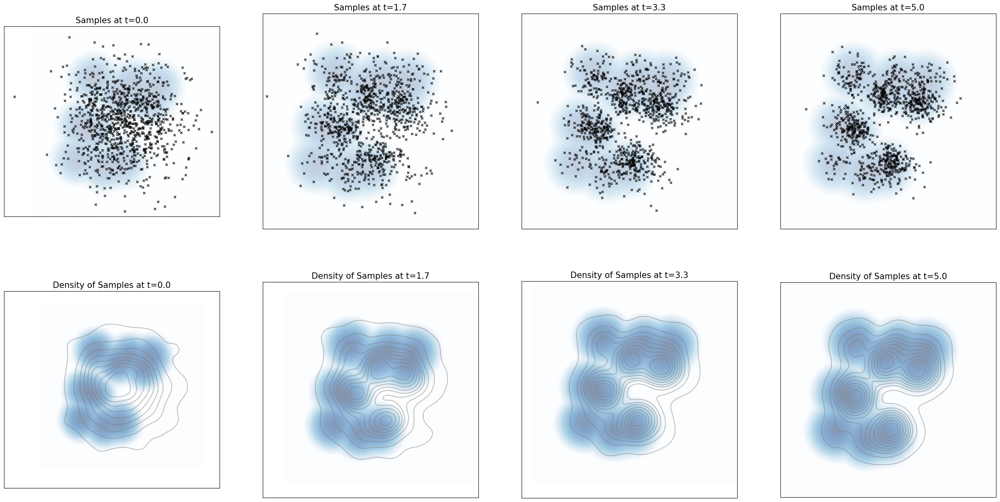

100%|██████████| 999/999 [00:00<00:00, 999.25it/s] 


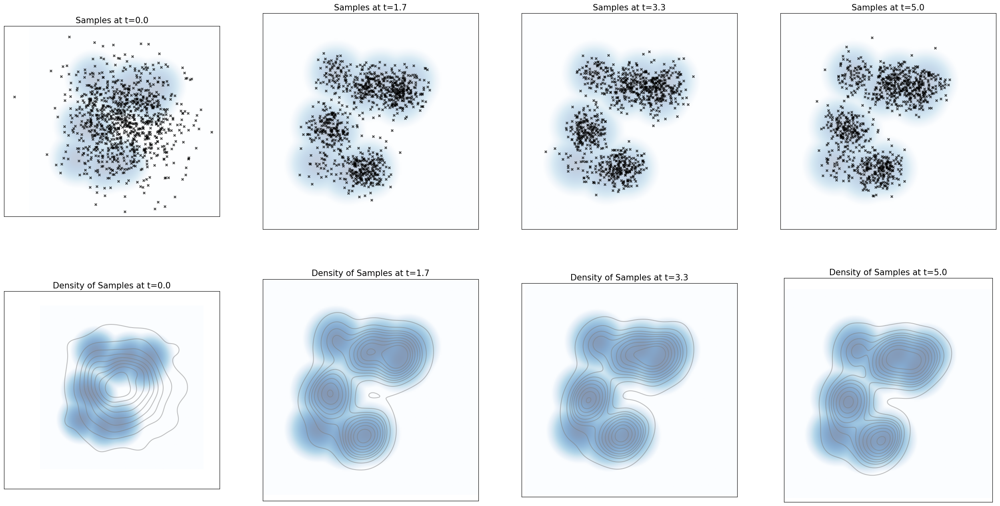

100%|██████████| 999/999 [00:00<00:00, 1022.49it/s]


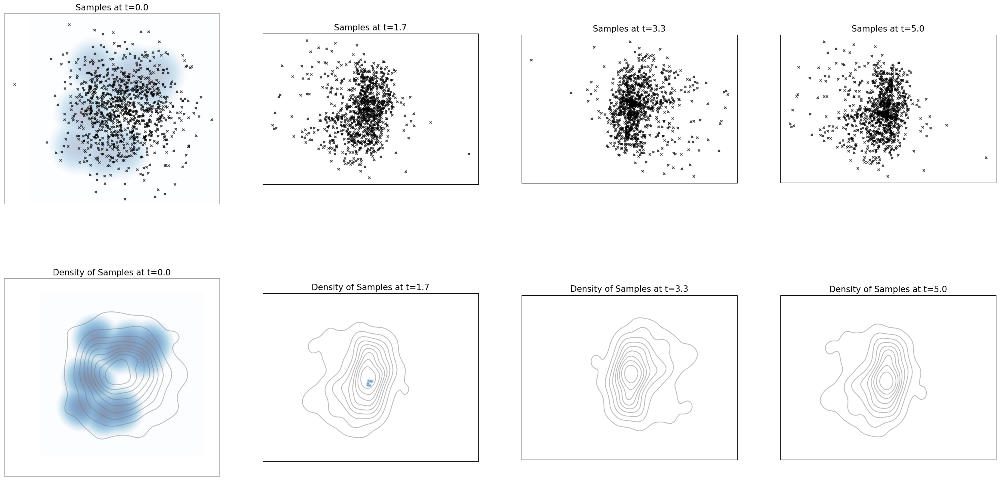

In [54]:
# Construct the simulator
for sigma in [0.5, 1.0, 10.0, 20.0, 100.0]:
    target = GaussianMixture.random_2D(nmodes=10, std=1.0, scale=15.0, seed=3.0).to(device)
    sde = LangevinSDE(sigma = sigma, density = target)
    simulator = EulerMaruyamaSimulator(sde)

    # Graph the results!
    graph_dynamics(
        num_samples = 1000,
        source_distribution = Gaussian(mean=torch.zeros(2), cov=20 * torch.eye(2)).to(device),
        simulator=simulator,
        density=target,
        timesteps=torch.linspace(0,5.0,1000).to(device),
        plot_every=334,
        bins=200,
        scale=15
    )   

100%|██████████| 2999/2999 [00:13<00:00, 224.48it/s]


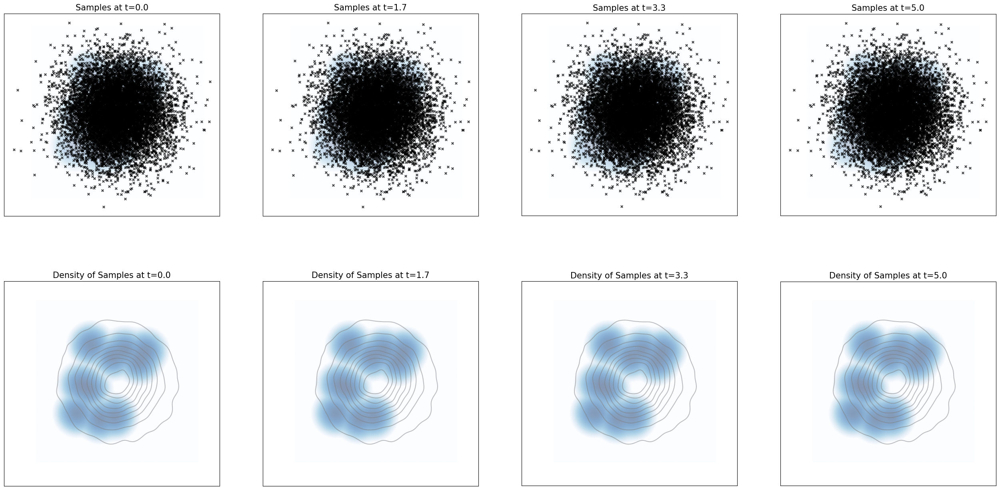

100%|██████████| 2999/2999 [00:13<00:00, 224.96it/s]


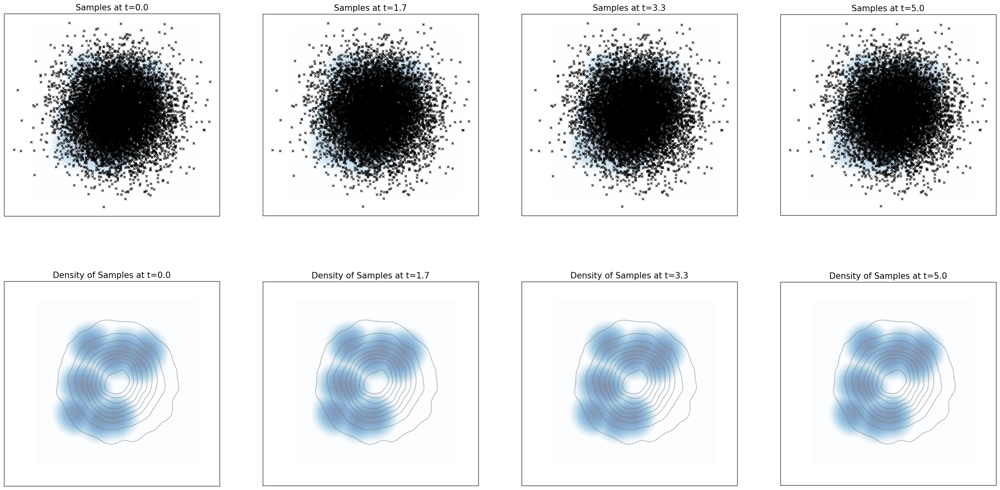

100%|██████████| 2999/2999 [00:13<00:00, 216.86it/s]


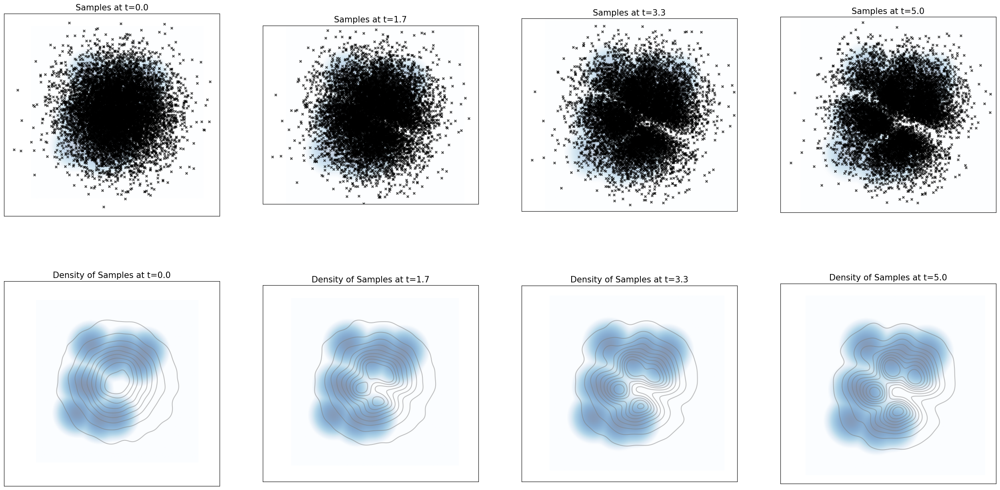

100%|██████████| 2999/2999 [00:13<00:00, 220.85it/s]


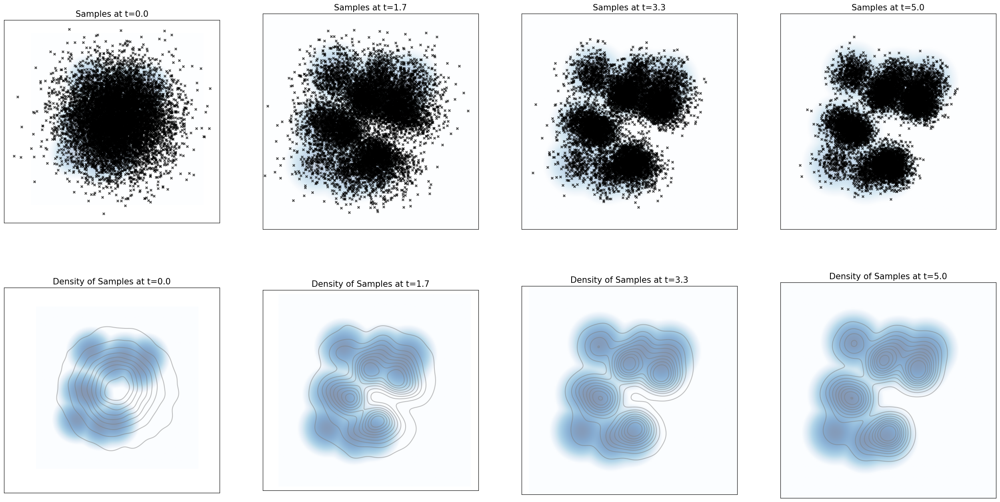

100%|██████████| 2999/2999 [00:13<00:00, 217.74it/s]


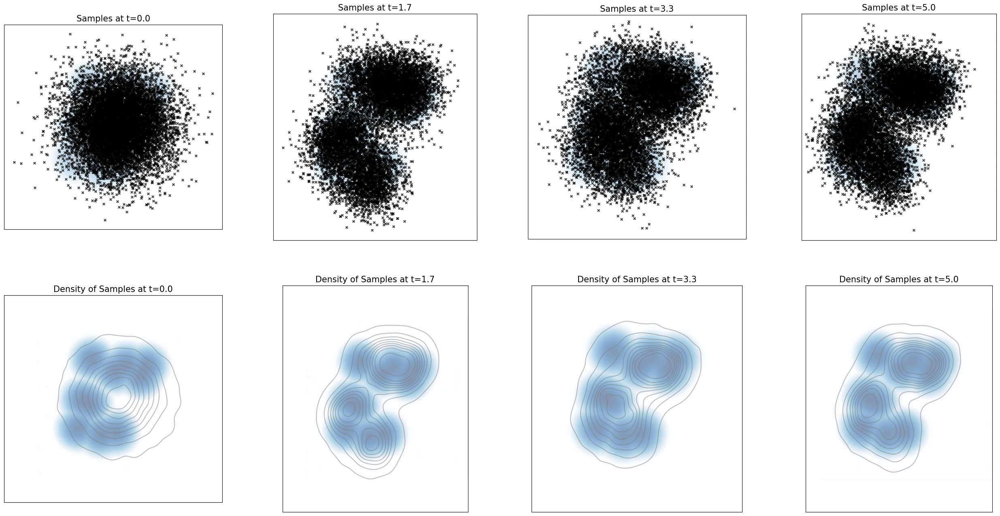

In [56]:
# Construct the simulator
for sigma in [0.5, 1.0, 10.0, 20.0, 50.0]:
    target = GaussianMixture.random_2D(nmodes=10, std=0.75, scale=15.0, seed=3.0).to(device)
    sde = LangevinSDE(sigma = sigma, density = target)
    simulator = EulerMaruyamaSimulator(sde)

    # Graph the results!
    graph_dynamics(
        num_samples = 10000,
        source_distribution = Gaussian(mean=torch.zeros(2), cov=20 * torch.eye(2)).to(device),
        simulator=simulator,
        density=target,
        timesteps=torch.linspace(0,5.0,3000).to(device),
        plot_every=1000,
        bins=200,
        scale=15
    )   

100%|██████████| 2999/2999 [00:13<00:00, 214.75it/s]


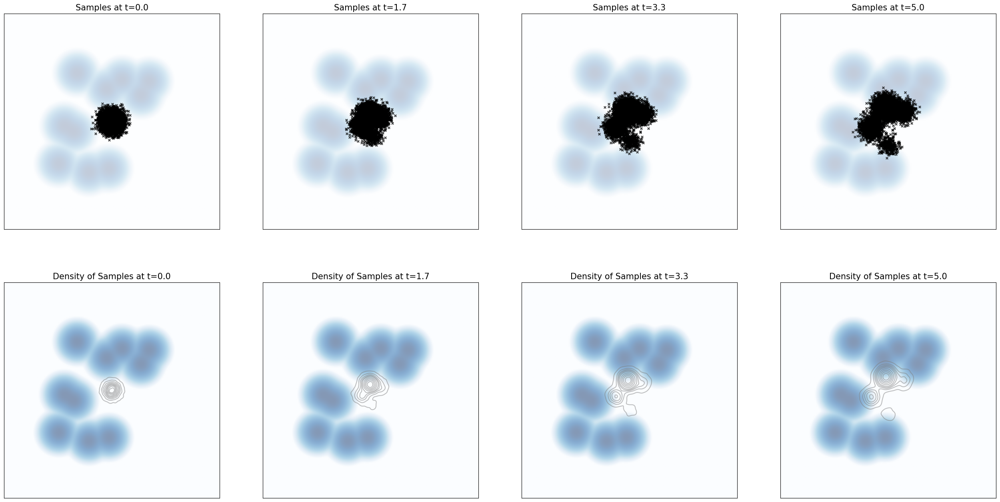

100%|██████████| 2999/2999 [00:14<00:00, 200.16it/s]


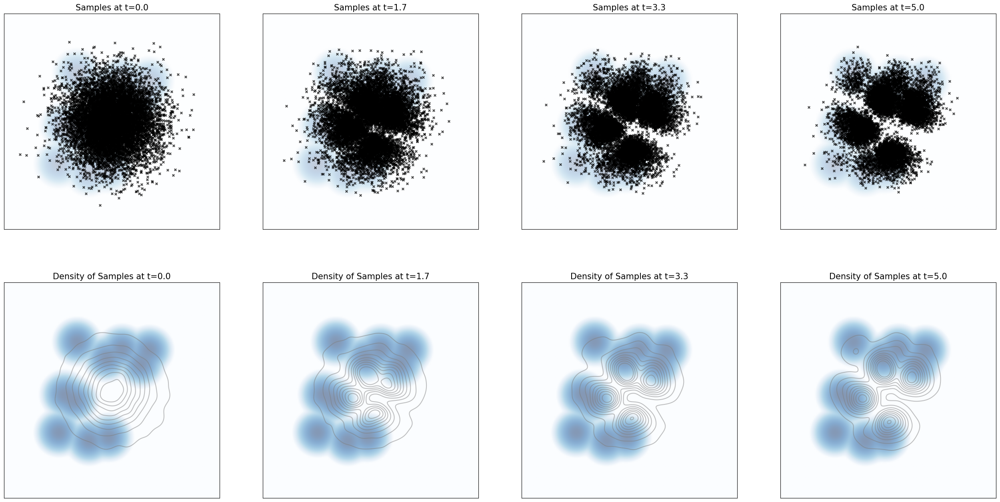

100%|██████████| 2999/2999 [00:14<00:00, 210.43it/s]


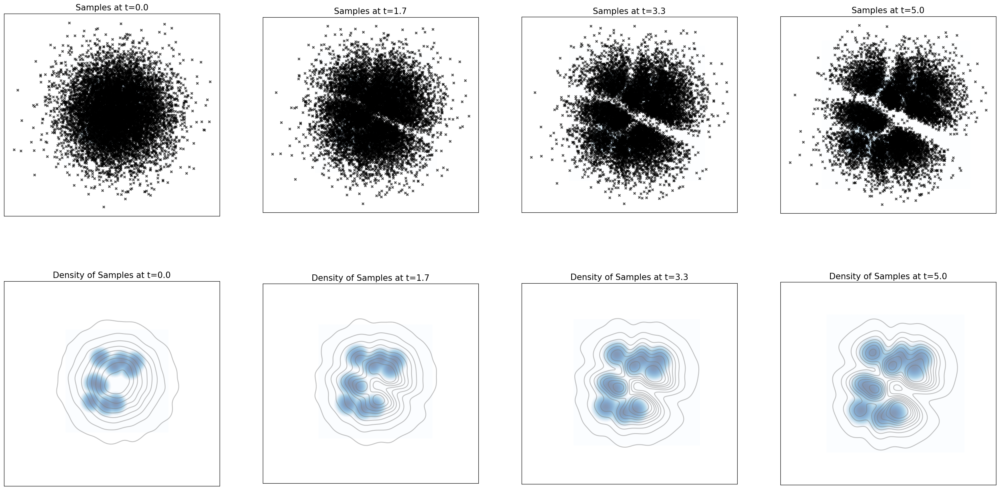

100%|██████████| 2999/2999 [00:14<00:00, 200.71it/s]


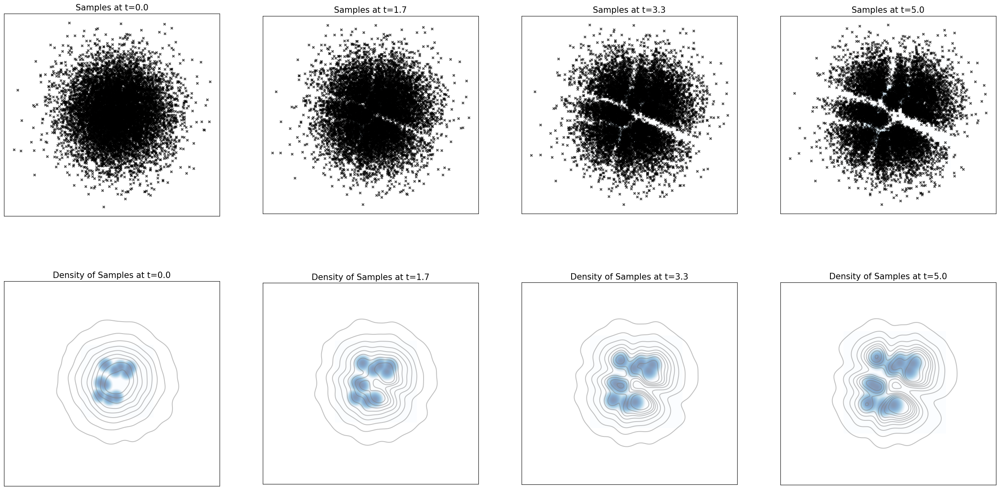

100%|██████████| 2999/2999 [00:14<00:00, 203.85it/s]


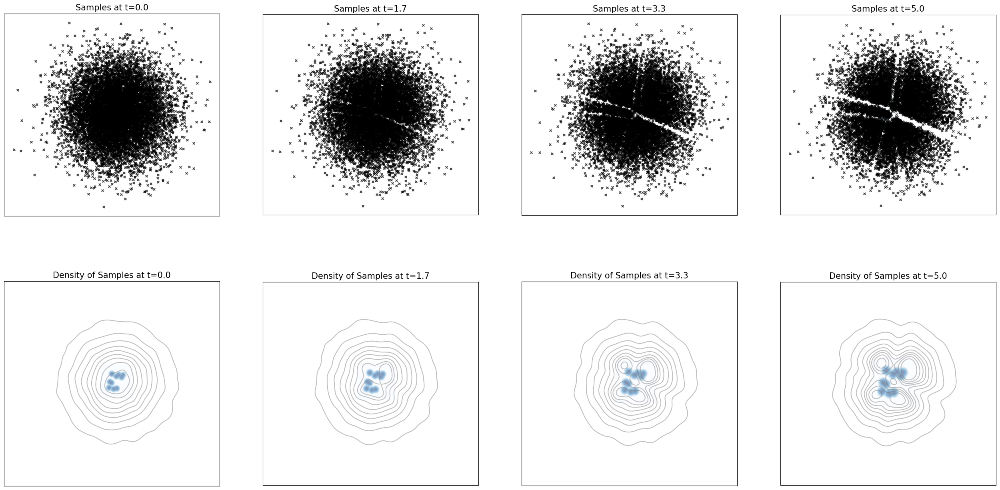

In [57]:
# Construct the simulator
for src_sigma_sq in [0.5, 10.0, 50.0, 100.0, 500.0]:
    target = GaussianMixture.random_2D(nmodes=10, std=0.75, scale=15.0, seed=3.0).to(device)
    sde = LangevinSDE(sigma = 10.0, density = target)
    simulator = EulerMaruyamaSimulator(sde)

    # Graph the results!
    graph_dynamics(
        num_samples = 10000,
        source_distribution = Gaussian(mean=torch.zeros(2), cov=src_sigma_sq * torch.eye(2)).to(device),
        simulator=simulator,
        density=target,
        timesteps=torch.linspace(0,5.0,3000).to(device),
        plot_every=1000,
        bins=200,
        scale=15
    )   

**Your job (1 point)**: Try varying the value of $\sigma$, the number and range of the simulation steps, the source distribution, and target density. What do you notice? Why?

**Your answer**: There seems to be a sweet spot for sigma. Obviously if sigma is really high then you will get lots of noise (you can see this in the very second to last case as sigma has gone over the sweet spot). On the other hand, if sigma is very low, then it takes a really long time to converge to the target distribution so you look, still, like gaussian noise in the end. If sigma is a just-right, you will converge faster i.e. because points will randomly get closer to SOME gaussian from the mixture and thereby fall into one of the possible distributions. Increasing the time gives it more time to converge (simulation steps). Changing the source distribution modifies how much the output, when sigma is to low, will look like (and source more aligned with the target will lead to faster convergence). Specifically, on this last point, when the source distribution is a tiny bit wider than the total mixture, there was enough mass close enough to fall quickly into place in the different mixture components (though if you made it just a little bit wider, as you can see, some points would be very far out OOD even if they had ONE component they most aligned with).

Note: To run the folowing two **optional** cells, you will need to download the `ffmpeg` library. You can do so using e.g., `conda install -c conda-forge ffmpeg` (or, ideally, `mamba`). Running `pip install ffmpeg` or similar will likely **not** work.

In [47]:
from celluloid import Camera
from IPython.display import HTML

def animate_dynamics(
    num_samples: int,
    source_distribution: Sampleable,
    simulator: Simulator, 
    density: Density,
    timesteps: torch.Tensor, 
    animate_every: int,
    bins: int,
    scale: float,
    save_path: str = 'dynamics_animation.mp4'
):
    """
    Plot the evolution of samples from source under the simulation scheme given by simulator (itself a discretization of an ODE or SDE).
    Args:
        - num_samples: the number of samples to simulate
        - source_distribution: distribution from which we draw initial samples at t=0
        - simulator: the discertized simulation scheme used to simulate the dynamics
        - density: the target density
        - timesteps: the timesteps used by the simulator
        - animate_every: number of timesteps between consecutive frames in the resulting animation
    """
    # Simulate
    x0 = source_distribution.sample(num_samples)
    xts = simulator.simulate_with_trajectory(x0, timesteps)
    indices_to_animate = every_nth_index(len(timesteps), animate_every)
    animate_timesteps = timesteps[indices_to_animate]

    # Graph
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    camera = Camera(fig)
    for t_idx in range(len(animate_timesteps)):
        t = animate_timesteps[t_idx].item()
        xt = xts[:,t_idx]
        # Scatter axes
        scatter_ax = axes[0]
        imshow_density(density, bins, scale, scatter_ax, vmin=-15, alpha=0.25, cmap=plt.get_cmap('Blues'))
        scatter_ax.scatter(xt[:,0].cpu(), xt[:,1].cpu(), marker='x', color='black', alpha=0.75, s=15)
        scatter_ax.set_title(f'Samples')

        # Kdeplot axes
        kdeplot_ax = axes[1]
        imshow_density(density, bins, scale, kdeplot_ax, vmin=-15, alpha=0.5, cmap=plt.get_cmap('Blues'))
        sns.kdeplot(x=xt[:,0].cpu(), y=xt[:,1].cpu(), alpha=0.5, ax=kdeplot_ax,color='grey')
        kdeplot_ax.set_title(f'Density of Samples', fontsize=15)
        kdeplot_ax.set_xticks([])
        kdeplot_ax.set_yticks([])
        kdeplot_ax.set_xlabel("")
        kdeplot_ax.set_ylabel("")
        camera.snap()
    
    animation = camera.animate()
    animation.save(save_path)
    plt.close()
    return HTML(animation.to_html5_video())

100%|██████████| 999/999 [00:00<00:00, 1360.71it/s]
MovieWriter ffmpeg unavailable; using Pillow instead.


ValueError: unknown file extension: .mp4

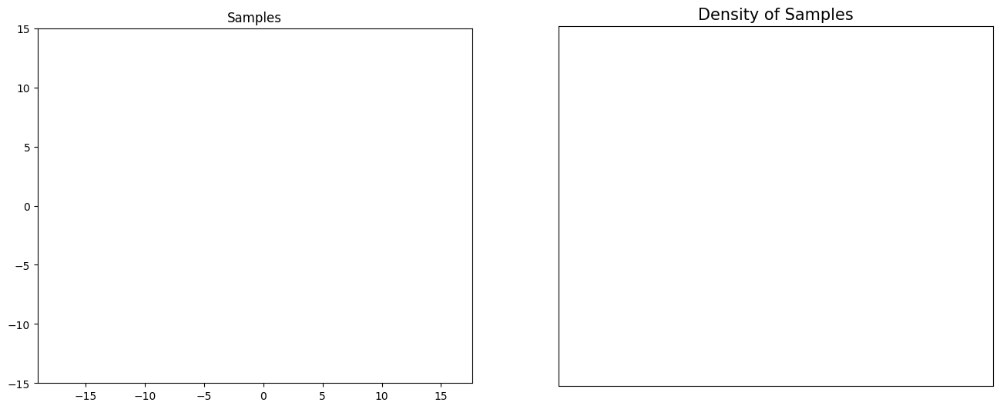

In [48]:
# OPTIONAL CELL
# Construct the simulator
target = GaussianMixture.random_2D(nmodes=5, std=0.75, scale=15.0, seed=3.0).to(device)
sde = LangevinSDE(sigma = 10.0, density = target)
simulator = EulerMaruyamaSimulator(sde)

# Graph the results!
animate_dynamics(
    num_samples = 1000,
    source_distribution = Gaussian(mean=torch.zeros(2), cov=20 * torch.eye(2)).to(device),
    simulator=simulator,
    density=target,
    timesteps=torch.linspace(0,1.5,1000).to(device),
    bins=200,
    scale=15,
    animate_every=100
)   

### Question 3.2: Ornstein-Uhlenbeck as Langevin Dynamics
In this section, we'll finish off with a brief mathematical exercise connecting Langevin dynamics and Ornstein-Uhlenbeck processes. Recall that for (suitably nice) distribution $p$, the *Langevin dynamics* are given by
$$dX_t = \frac{1}{2} \sigma^2\nabla \log p(X_t) dt + \sigma\, dW_t, \quad \quad X_0 = x_0,$$
while for given $\theta, \sigma$, the Ornstein-Uhlenbeck process is given by
$$ dX_t = -\theta X_t\, dt + \sigma\, dW_t, \quad \quad X_0 = x_0.$$.

**Your job (2 points)**: Show that when $p(x) = N(0, \frac{\sigma^2}{2\theta})$, the score is given by $$\nabla \log p(x) = -\frac{2\theta}{\sigma^2}x.$$

**Hint**: The probability density of the Gaussian $p(x) = N(0, \frac{\sigma^2}{2\theta})$ is given by $$p(x) = \frac{1}{\sigma \sqrt{2\pi}} \exp\left(-\frac{x^2\theta}{\sigma^2}\right).$$

**Your answer**: This is one dimensional, but easily generalizes. Just take the log of the gaussian wich is scaled exponential to a quadratic, so you get out that quadratic: $-(\theta x^2)/(\sigma^2)$ where $x$ is your point (i.e. we are looking at $p(x)$). Note that we ignored the scaling factor because logarithm of a product of two elements is the sum of the logarithms and one of those two terms (the one with the two pi) is a constant in $x$: $\log(p(x)) = \log(1/\sigma\sqrt{2\pi}) - (\theta x^2)/(\sigma^2)$ and the gradient zeros out the first term of hte RHS. Then you take the derivative and the two comes down from the exponent so you get $-\frac{2\theta}{\sigma^2}x$.

**Your job (1 point)**: Conclude that when $p(x) = N(0, \frac{\sigma^2}{2\theta})$, the Langevin dynamics 
$$dX_t = \frac{1}{2} \sigma^2\nabla \log p(X_t) dt + \sigma dW_t,$$
is equivalent to the Ornstein-Uhlenbeck process
$$ dX_t = -\theta X_t\, dt + \sigma\, dW_t, \quad \quad X_0 = 0.$$

**Your answer**: Note how we scaled this in the definition above of the LD process by $0.5\sigma^2$, so this "0.5" cancels the two in the numerator and the $\sigma^2$ cancels likewise in the denominator. This means that we end up with the first term in the sum above as $-\theta x dt$, or, in the notation used: $-\theta X_t dt$. The second term was the same anyways, so you can see the equivalence.